# Generic Unet for Fiji 

In [4]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
import skimage
from PIL import Image
import random
import utils
import shutil
import os

In [5]:
data='/n/core/micro/asa/fgm/smc/20191029_3PO_HighMag/DeepLearn/'

In [6]:
base_scaler=32

In [7]:
x_dim=256
y_dim=256
channels=2

mean=153.0
std=237.0

# Get data

Load data from file

In [8]:
both=skimage.external.tifffile.imread(data+'Training_windowed.tif')
both=np.swapaxes(np.swapaxes(both,2,3), 3,4)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-1

In [9]:
train_data=both[:,:,:,:,[0,1]]
train_truth=both[:,:,:,:,[2]]

both=0

#non_zeros=np.where(train_data!=0)
#mean=np.mean(train_data)
#std=np.std(train_data)


train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1
train_truth[np.where(train_truth<0)]=0



In [13]:
validation=skimage.external.tifffile.imread(data+'Validation.tif')
validation=np.swapaxes(np.swapaxes(validation,2,3), 3,4)

validation_data=validation[:,:,:,:,[0,1]]
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,:,[2]]
validation_truth[np.where(validation_truth>0.1)]=1
validation_truth[np.where(validation_truth<0)]=0

In [12]:
print([mean, std])

[153.49832, 237.67056]


# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [16]:
tf.reset_default_graph()
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, 8, 256,256,2])
y=tf.placeholder(dtype=tf.float32, shape=[None, 8, 256,256,1])

lr=tf.placeholder(dtype=tf.float32, shape=[], name='learning_rate')
dr=tf.placeholder(dtype=tf.float32, shape=[], name='dropout_rate')

regularizer = tf.contrib.layers.l2_regularizer(scale=0.1)

xr=x
yr=y

base_scaler=32

#Going down
A1=utils.leaky_relu(tf.layers.conv3d(xr, base_scaler, [3,5,5], padding='SAME', kernel_regularizer=regularizer))
A2=utils.leaky_relu(tf.layers.conv3d(A1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

B0=tf.nn.max_pool3d(A2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
B1=utils.leaky_relu(tf.layers.conv3d(B0, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
B2=utils.leaky_relu(tf.layers.conv3d(B1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

C0=tf.nn.max_pool3d(B2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
C1=utils.leaky_relu(tf.layers.conv3d(C0, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
C2=utils.leaky_relu(tf.layers.conv3d(C1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

D0=tf.nn.max_pool3d(C2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
D1=utils.leaky_relu(tf.layers.conv3d(D0, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
D2=utils.leaky_relu(tf.layers.conv3d(D1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

E0=tf.nn.max_pool3d(D2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
E1=utils.leaky_relu(tf.layers.conv3d(E0, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
E2=utils.leaky_relu(tf.layers.conv3d(E1, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

#Coming up
DD0=tf.layers.conv3d_transpose(E2, 8*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
DD1=tf.concat(axis=4, values=[DD0,D2])
DD2=utils.leaky_relu(tf.layers.conv3d(DD1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
DD3=utils.leaky_relu(tf.layers.conv3d(DD2, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

CC0=tf.layers.conv3d_transpose(DD3, 4*base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
CC1=tf.concat(axis=4, values=[CC0,C2])
CC2=utils.leaky_relu(tf.layers.conv3d(CC1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
CC3=utils.leaky_relu(tf.layers.conv3d(CC2, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

BB0=tf.layers.conv3d_transpose(CC3, 2*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
#BB0=tf.contrib.layers.conv2d_transpose(C2, 2*base_scaler, kernel_size=[3,3], stride=[2, 2], padding='SAME')
BB1=tf.concat(axis=4, values=[BB0,B2])
BB2=utils.leaky_relu(tf.layers.conv3d(BB1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
BB3=utils.leaky_relu(tf.layers.conv3d(BB2, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

AA0=tf.layers.conv3d_transpose(BB3, base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
AA1=tf.concat(axis=4, values=[AA0,A2])
AA2=utils.leaky_relu(tf.layers.conv3d(AA1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
AA3=utils.leaky_relu(tf.layers.conv3d(AA2, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

logits=utils.leaky_relu(tf.layers.conv3d(AA3, 1, [1,1,1], padding='SAME', kernel_regularizer=regularizer))
probs=tf.tanh(logits, name='probabilities')

diff=tf.subtract(probs, yr)
LSQ=tf.multiply(diff,diff)
loss=1*tf.reduce_mean(LSQ[:,:,:,:,0])#+0.1*tf.reduce_mean(LSQ[:,:,:,:,1])+5*tf.reduce_mean(LSQ[:,:,:,:,2])
#Added this to make the outlines more potent in error function
#OutError, MaskError=tf.split(LSQ, [1,1], 3)
#loss=1*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
l2_loss = tf.losses.get_regularization_loss()
#loss=loss+l2_loss/1000

train_op=tf.train.AdamOptimizer(learning_rate=lr, name='trainer').minimize(loss)

tf.summary.scalar('loss', loss)
#tf.summary.image('input', x, 10)
#tf.summary.image('standard', y, 10)
#tf.summary.image('processed', probs, 10)


merge = tf.summary.merge_all()

# Training

0
Training loss:  0.0010443928
(3, 8, 256, 256, 1)
Validation loss:  0.006057007


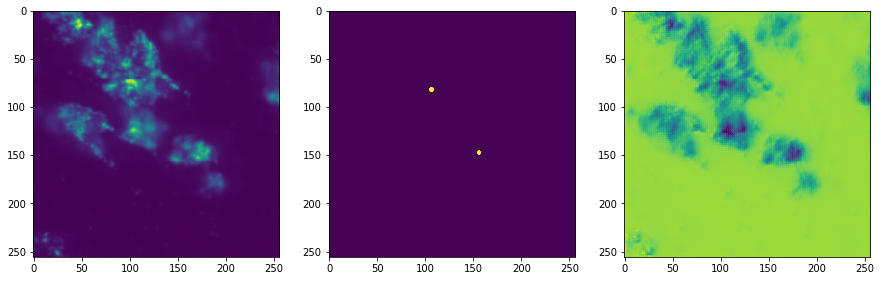

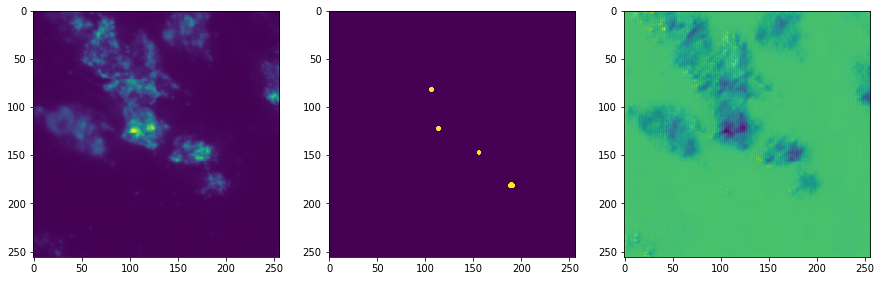

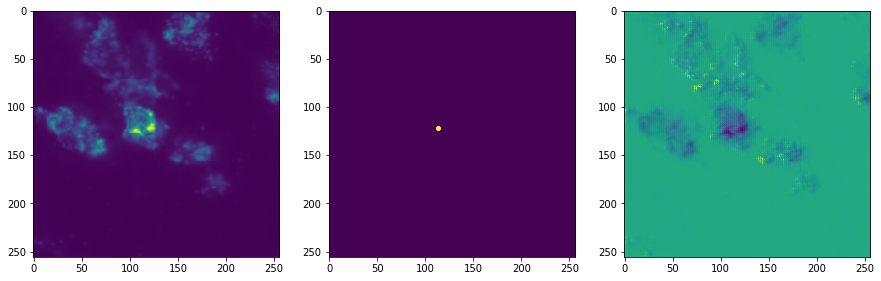

100
Training loss:  0.0005011734
(3, 8, 256, 256, 1)
Validation loss:  0.000654711


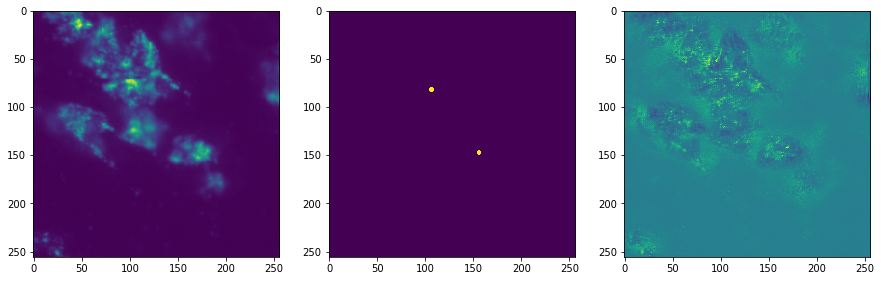

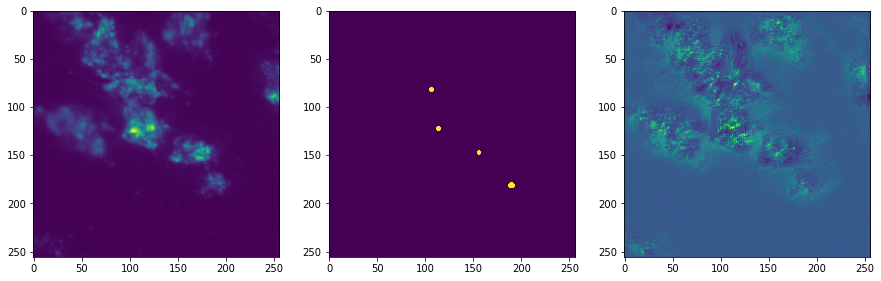

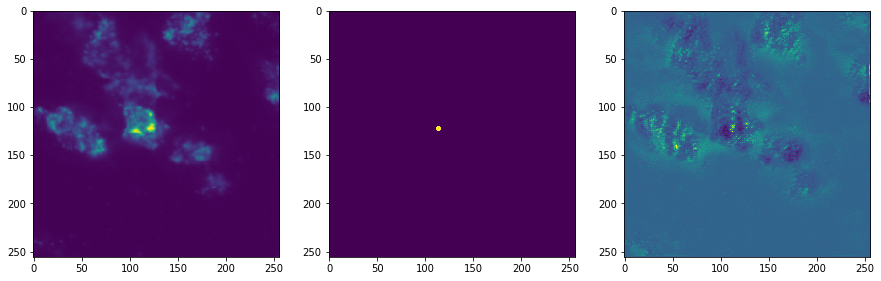

200
Training loss:  0.00035809193
(3, 8, 256, 256, 1)
Validation loss:  0.00062671036


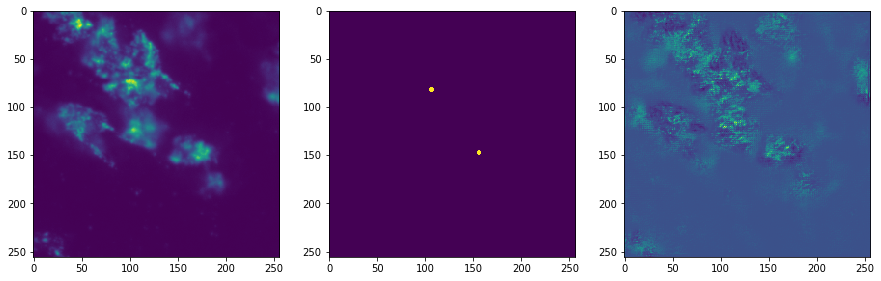

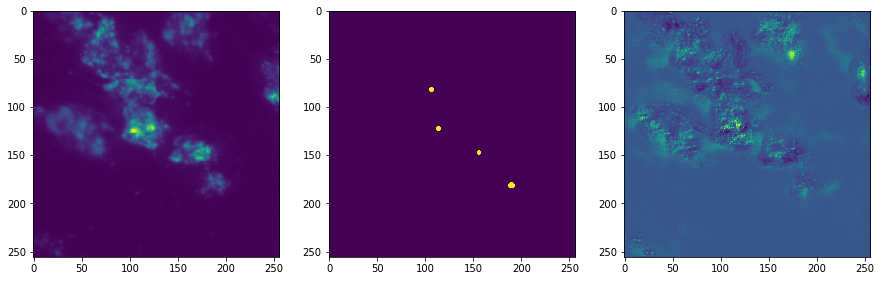

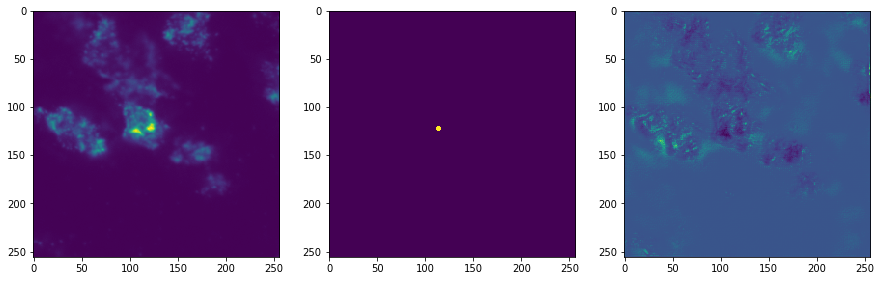

300
Training loss:  0.00015342222
(3, 8, 256, 256, 1)
Validation loss:  0.0006621567


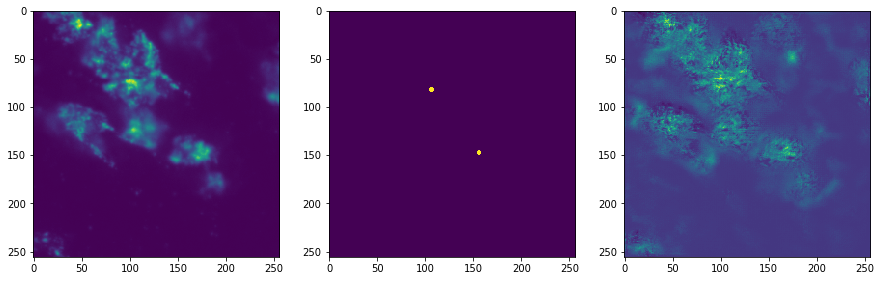

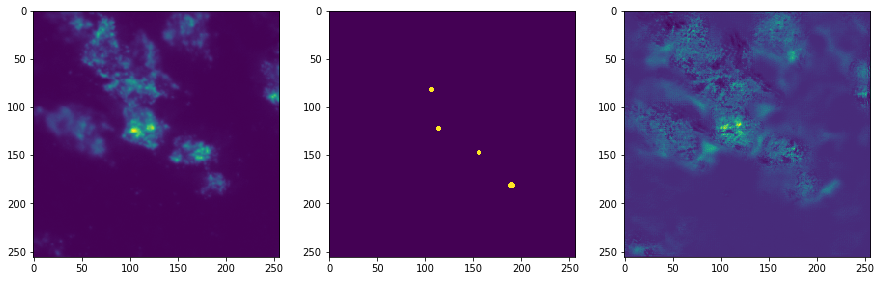

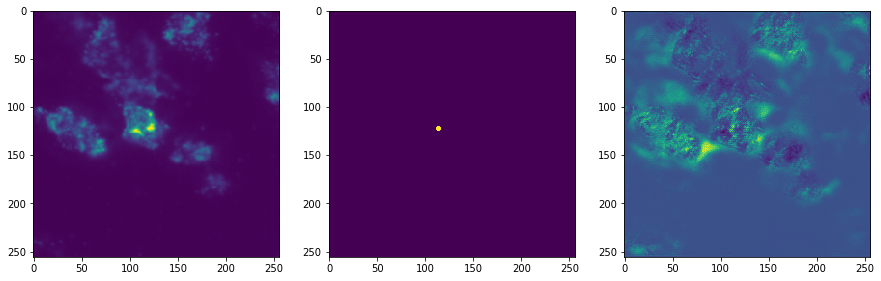

400
Training loss:  0.0007485871
(3, 8, 256, 256, 1)
Validation loss:  0.00063449383


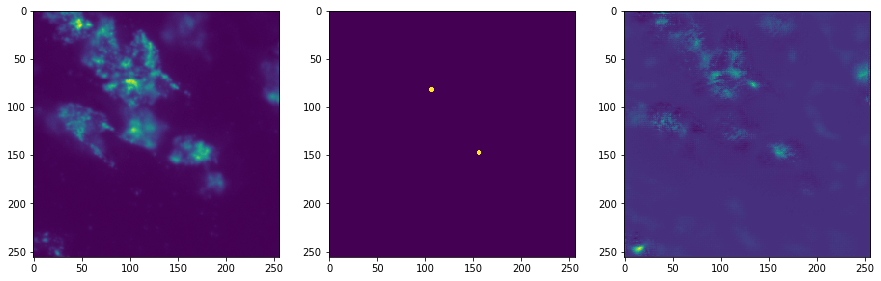

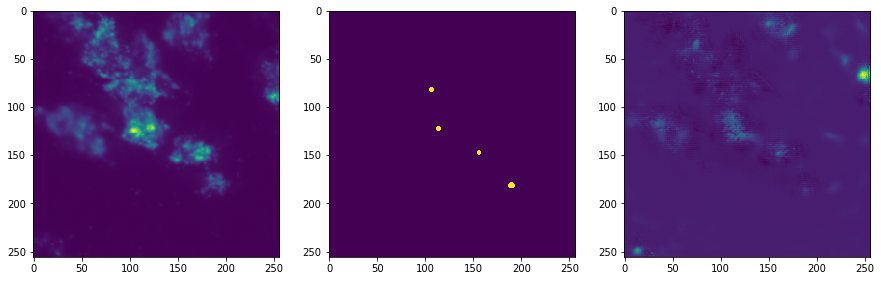

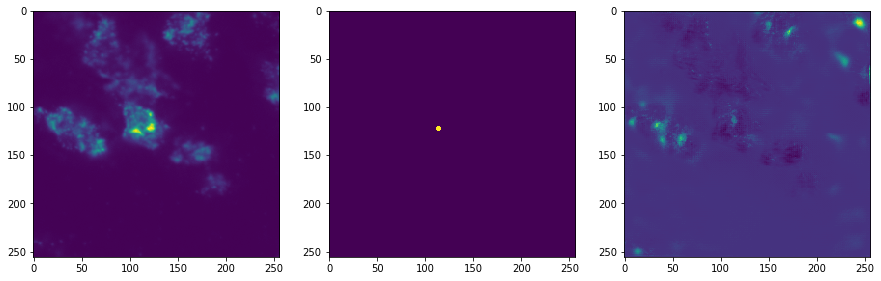

500
Training loss:  0.0002754066
(3, 8, 256, 256, 1)
Validation loss:  0.0006299702


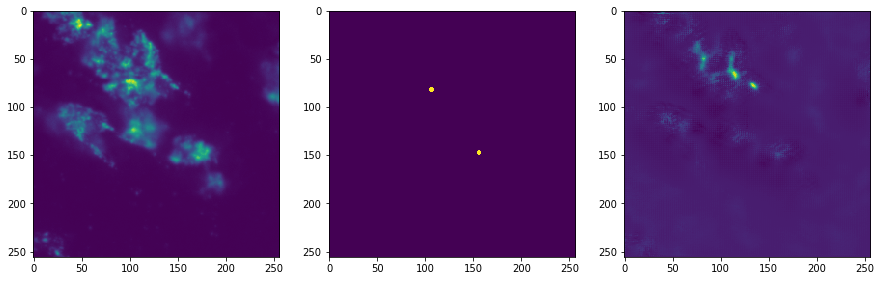

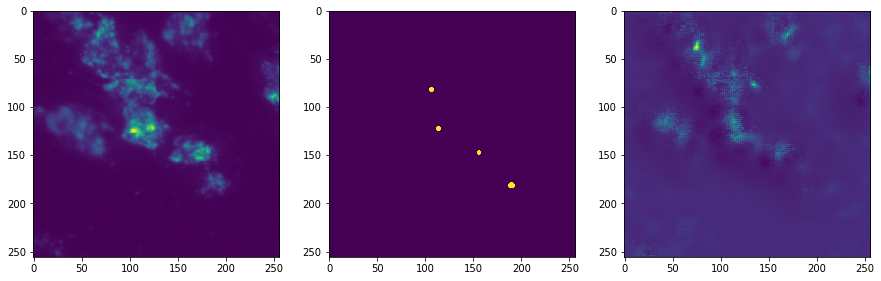

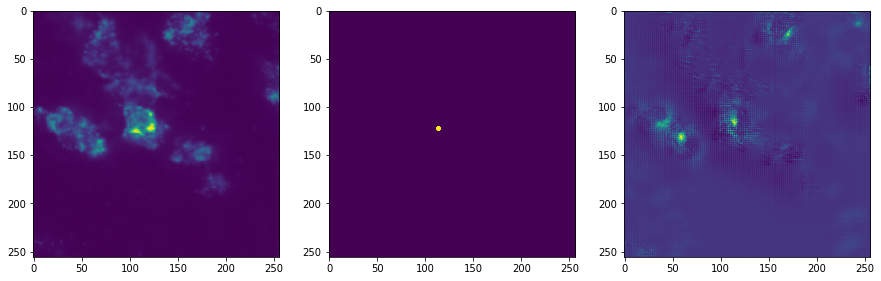

600
Training loss:  0.00016659808
(3, 8, 256, 256, 1)
Validation loss:  0.00061520725


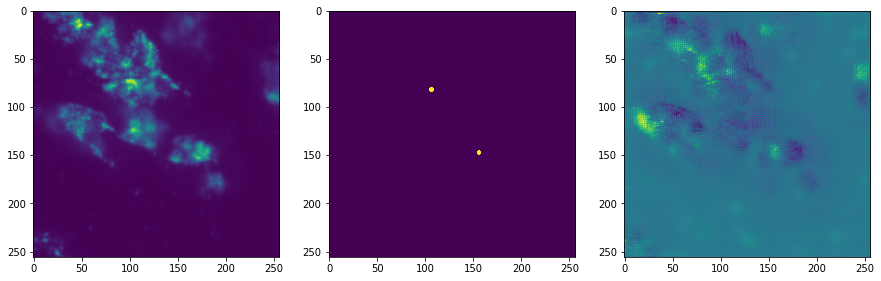

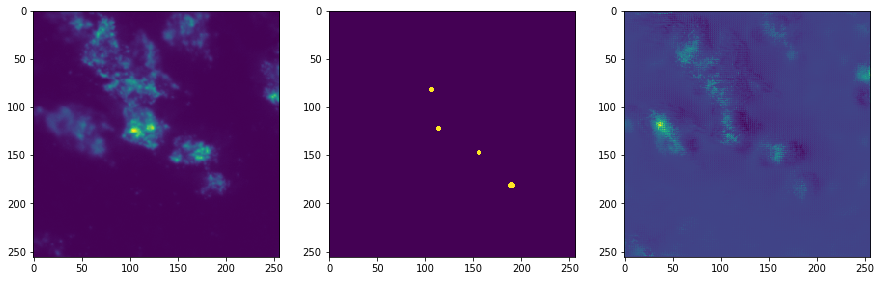

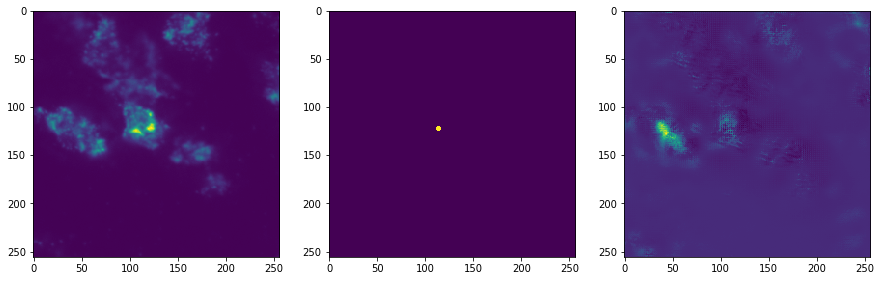

700
Training loss:  0.0009897115
(3, 8, 256, 256, 1)
Validation loss:  0.000615864


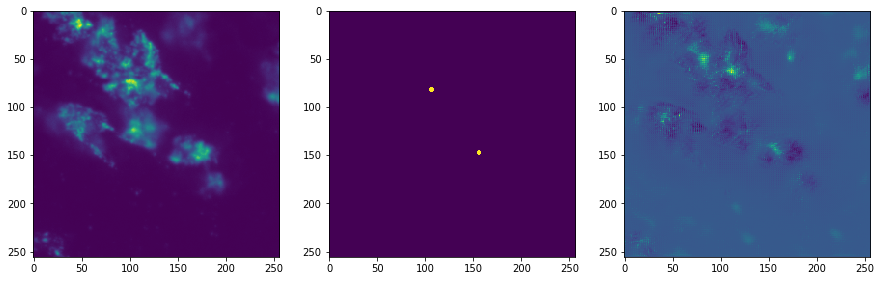

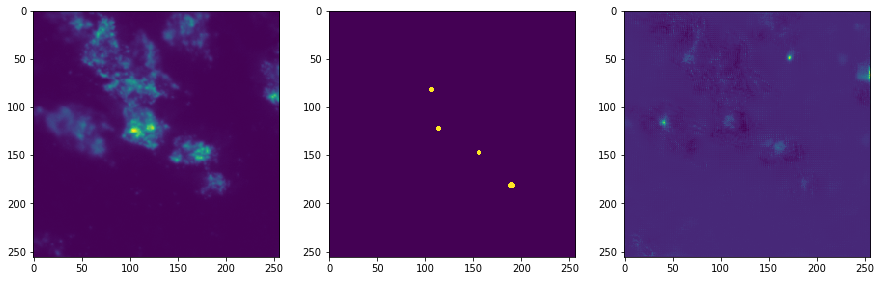

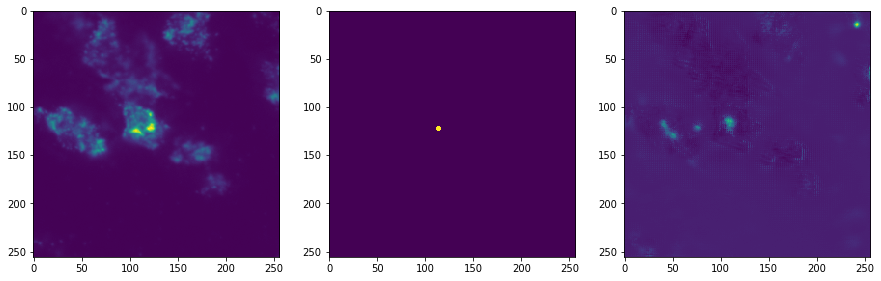

800
Training loss:  0.00053505483
(3, 8, 256, 256, 1)
Validation loss:  0.0006154005


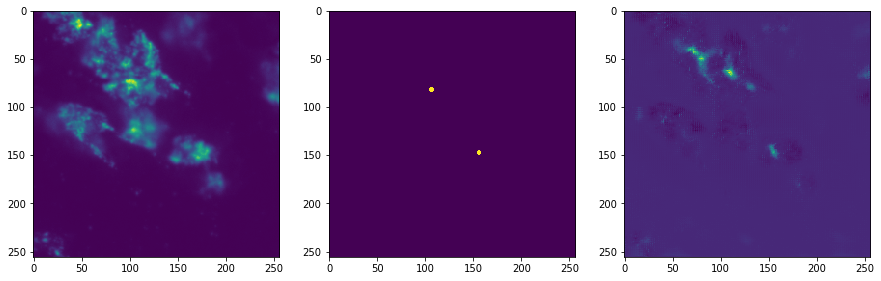

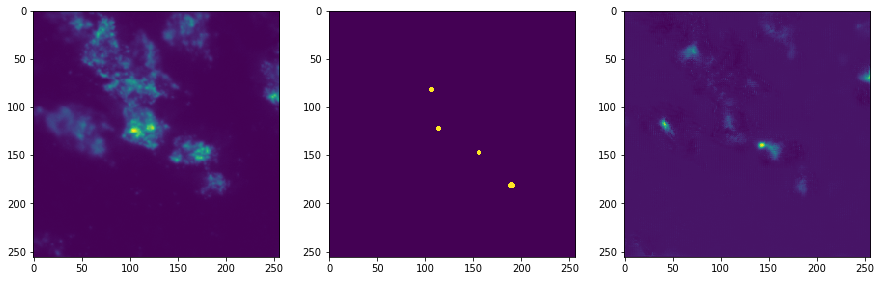

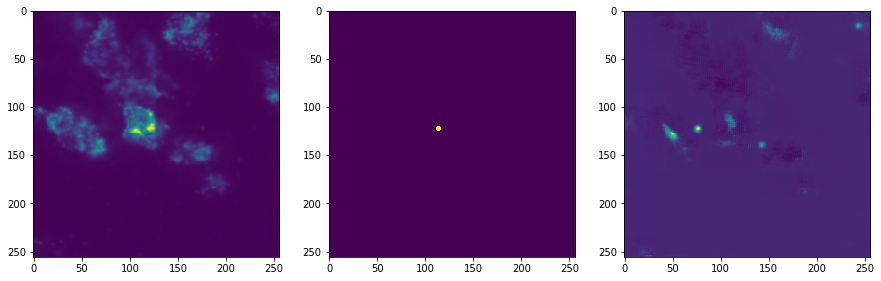

900
Training loss:  0.00031486285
(3, 8, 256, 256, 1)
Validation loss:  0.0006192498


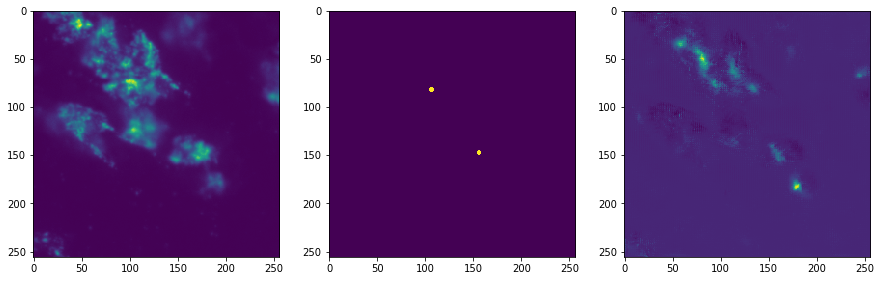

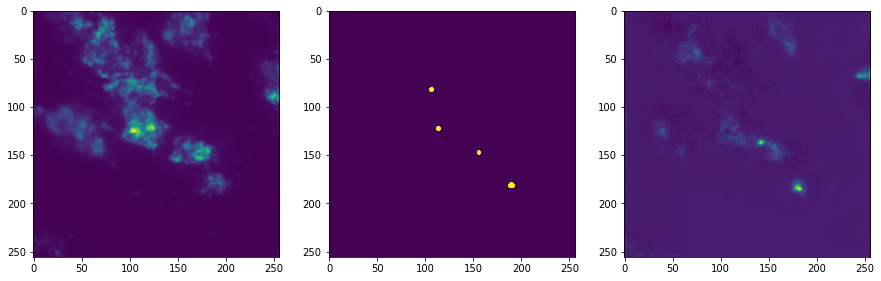

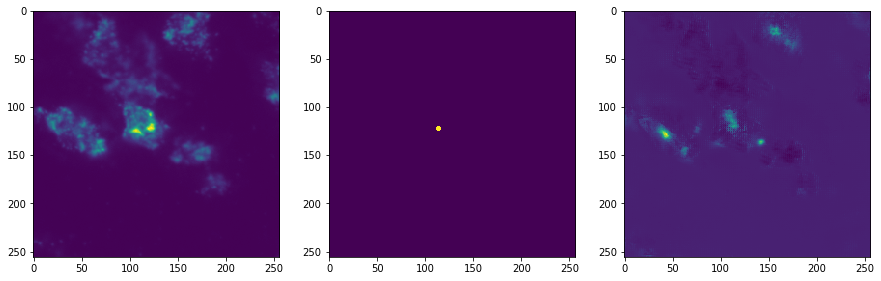

1000
Training loss:  0.0005422355
(3, 8, 256, 256, 1)
Validation loss:  0.000614697


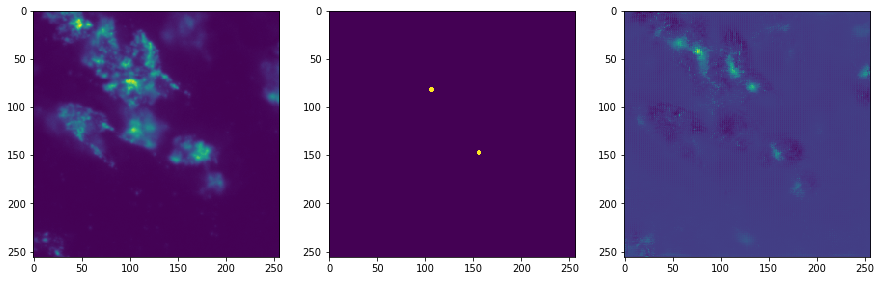

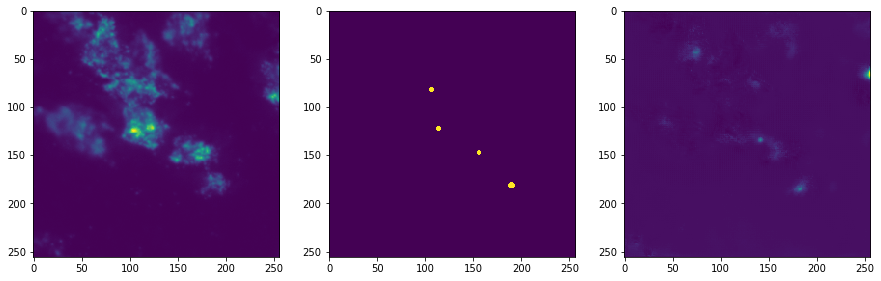

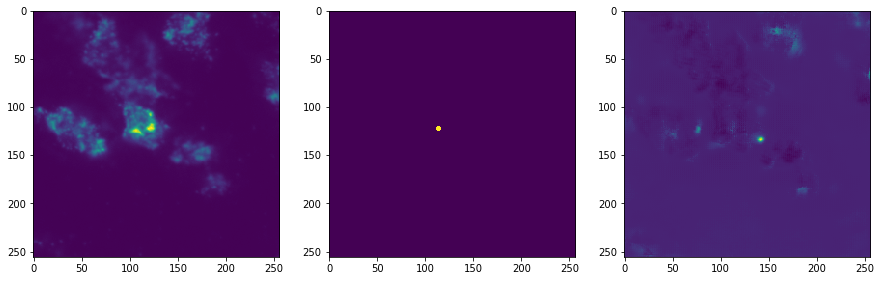

1100
Training loss:  0.00065224816
(3, 8, 256, 256, 1)
Validation loss:  0.0006217764


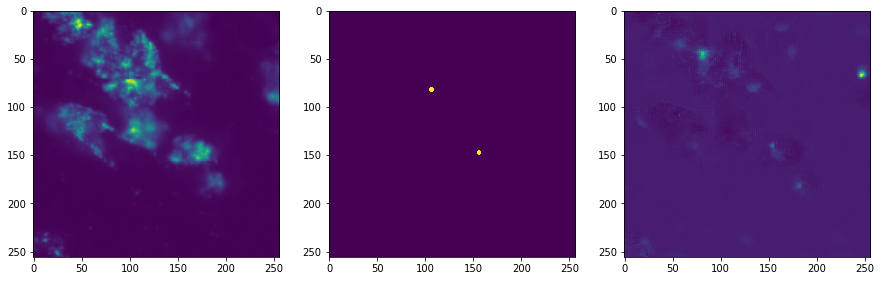

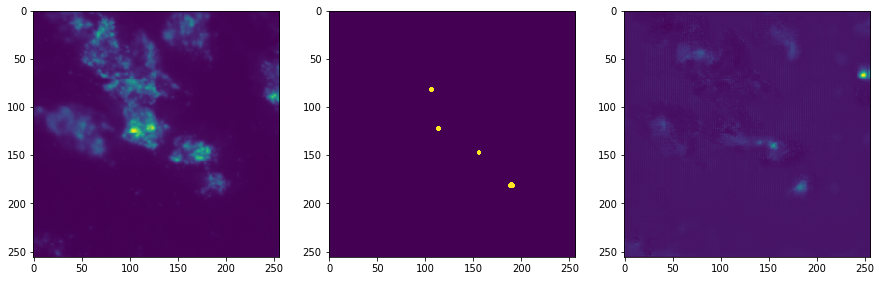

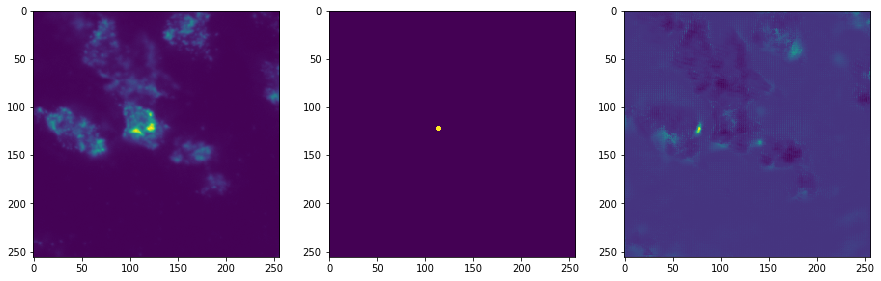

1200
Training loss:  0.00022668678
(3, 8, 256, 256, 1)
Validation loss:  0.00074989046


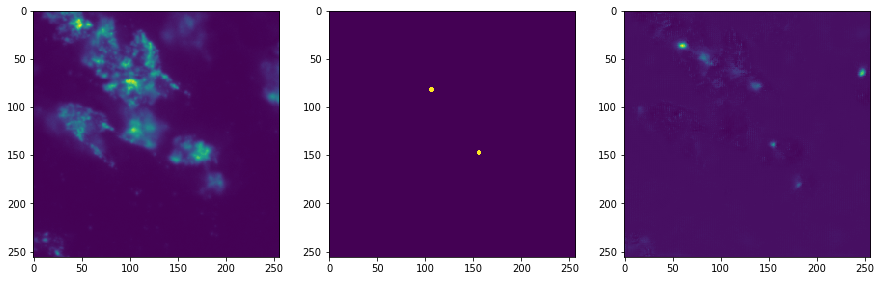

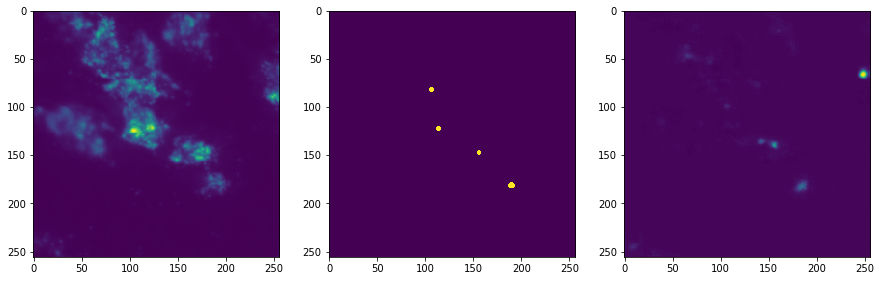

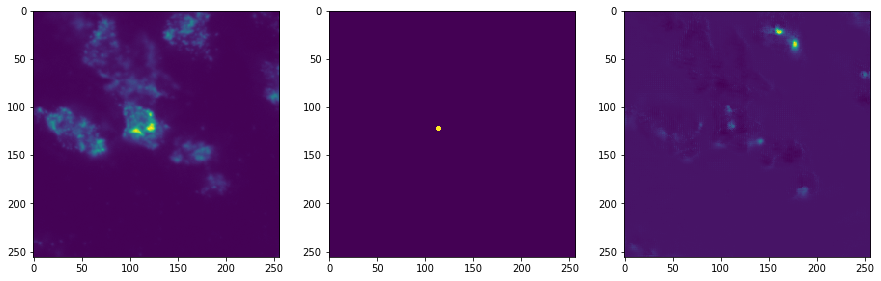

1300
Training loss:  0.00026347145
(3, 8, 256, 256, 1)
Validation loss:  0.00089305616


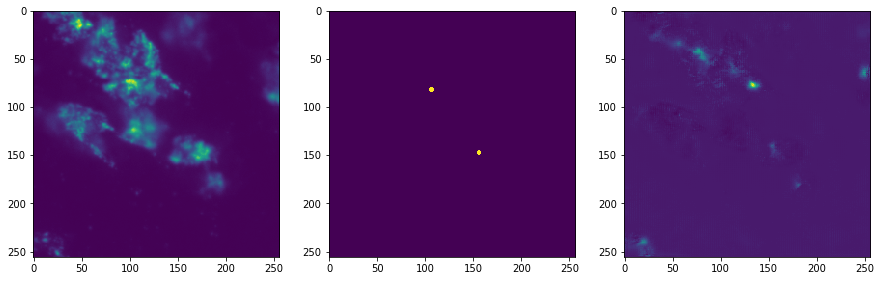

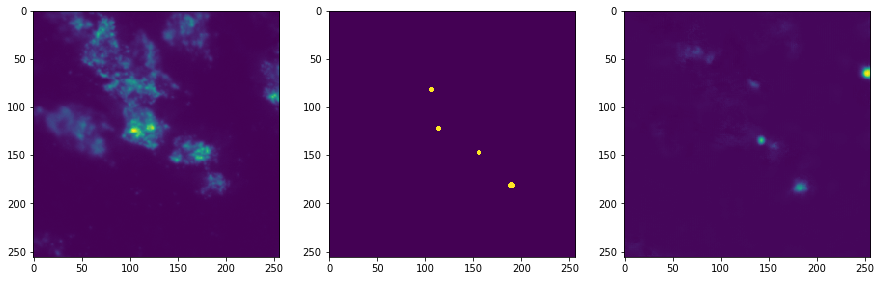

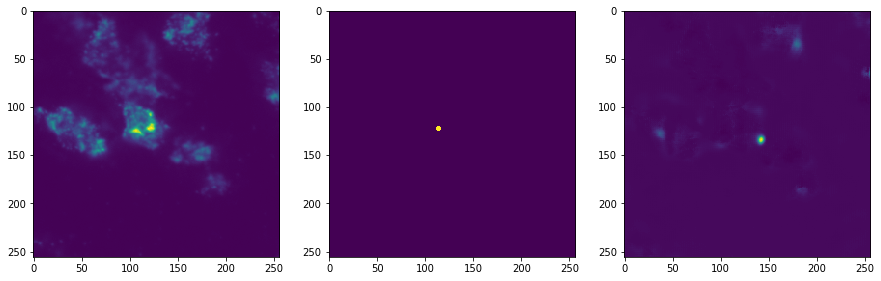

1400
Training loss:  0.0005385574
(3, 8, 256, 256, 1)
Validation loss:  0.0009921159


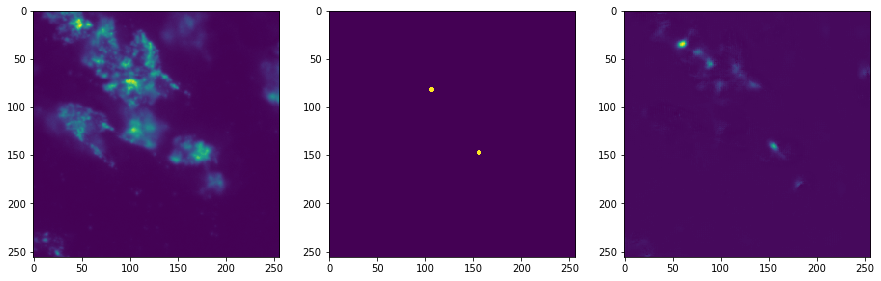

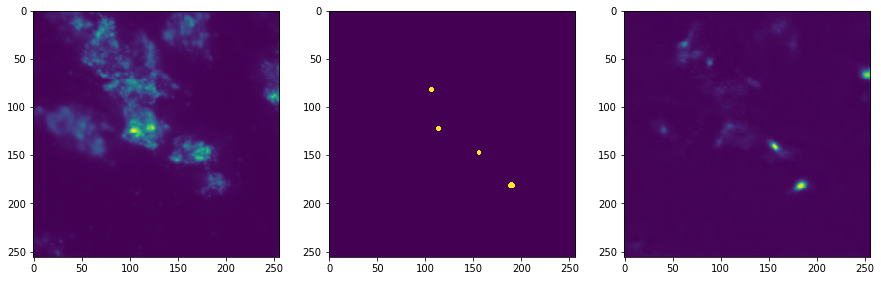

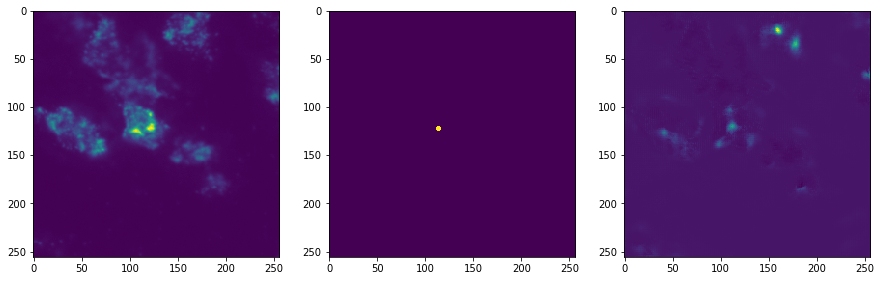

1500
Training loss:  0.00029335433
(3, 8, 256, 256, 1)
Validation loss:  0.0010923432


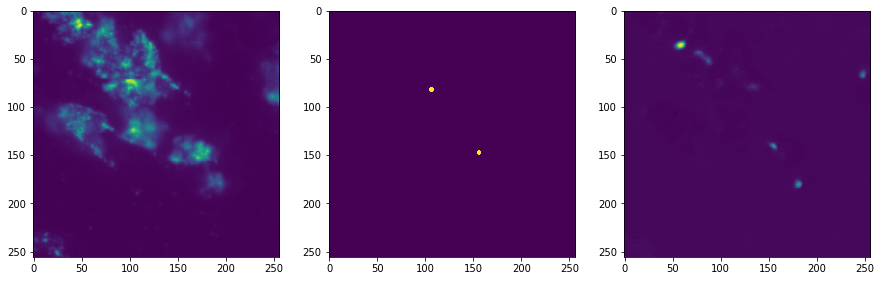

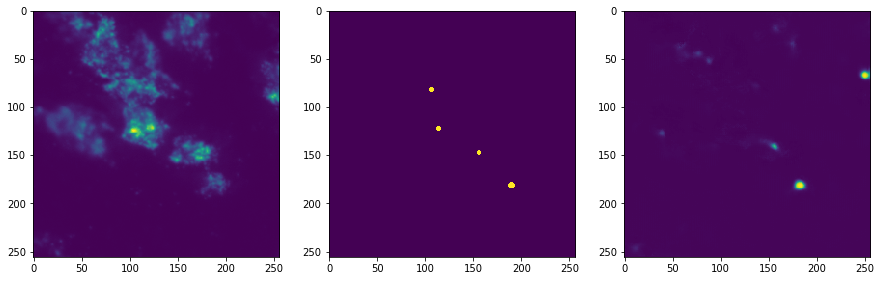

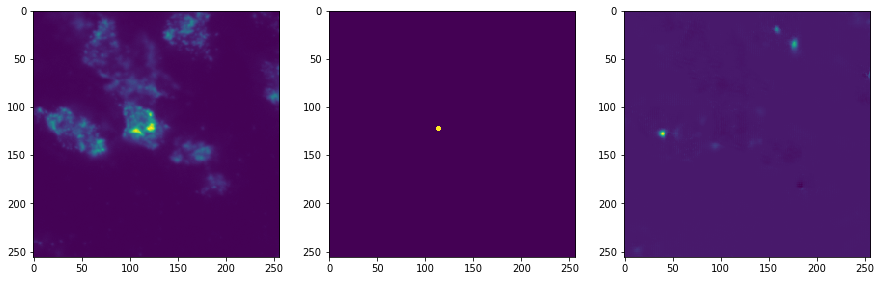

1600
Training loss:  0.00013028424
(3, 8, 256, 256, 1)
Validation loss:  0.0007898418


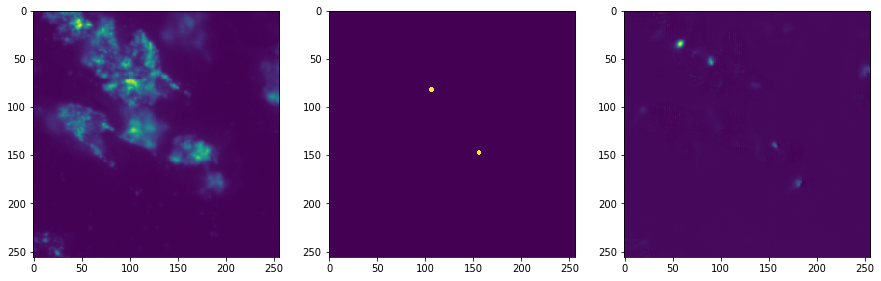

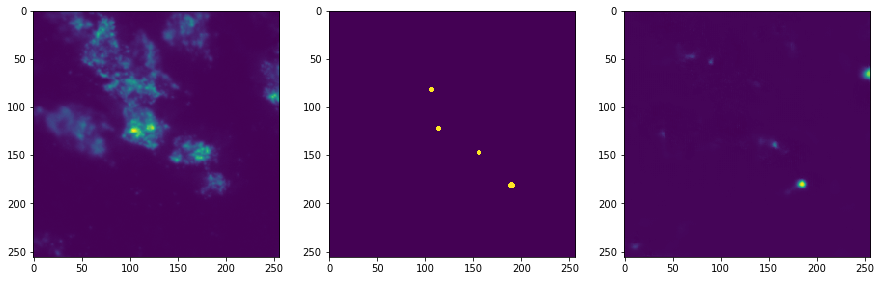

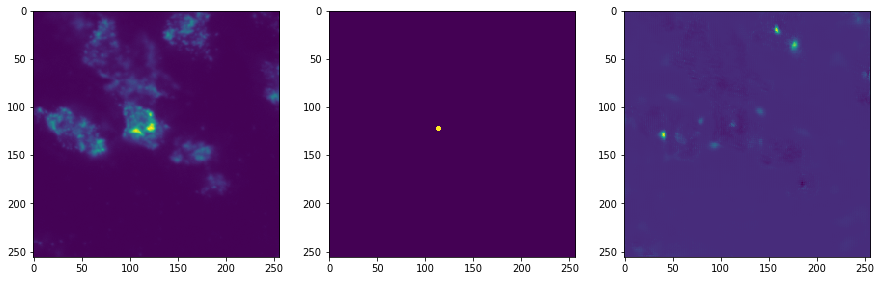

1700
Training loss:  0.00028498625
(3, 8, 256, 256, 1)
Validation loss:  0.00096604344


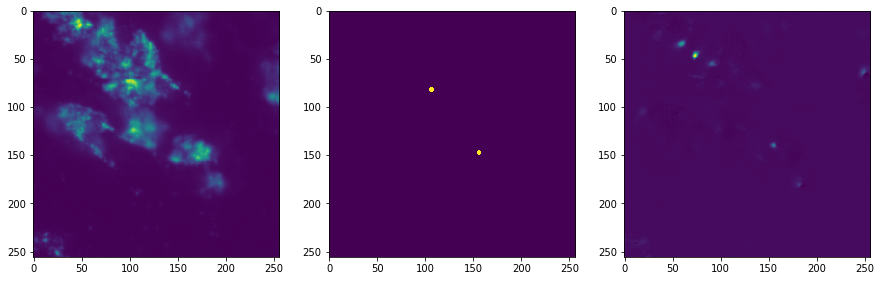

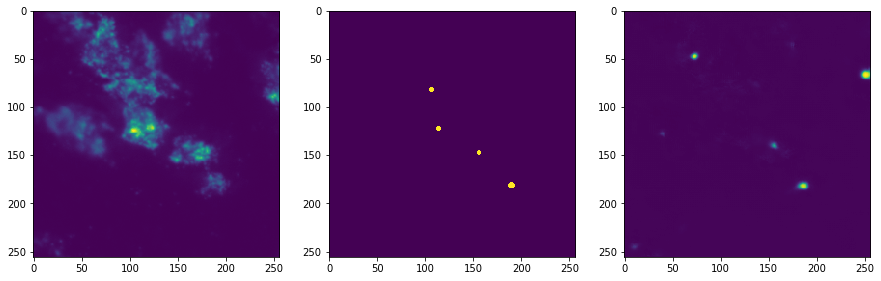

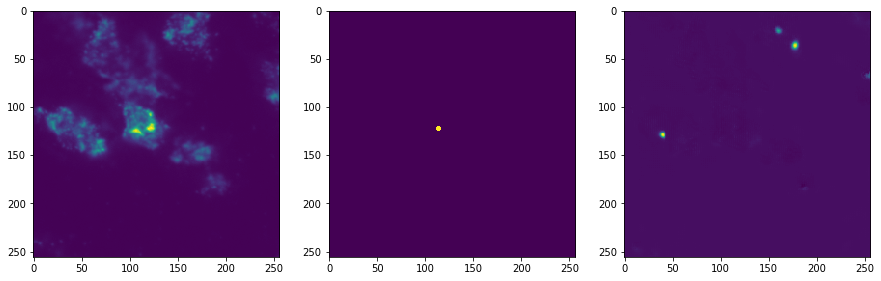

1800
Training loss:  0.00037372528
(3, 8, 256, 256, 1)
Validation loss:  0.00097609794


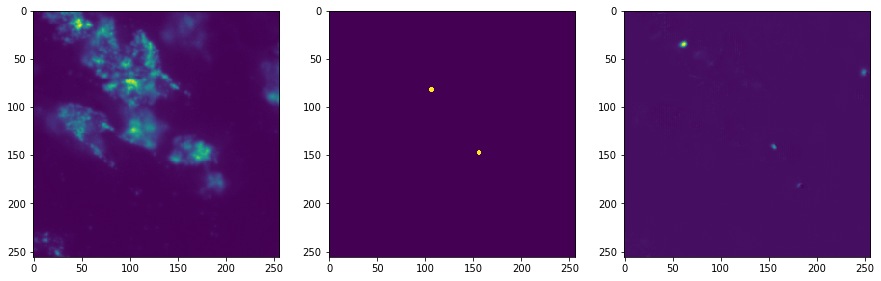

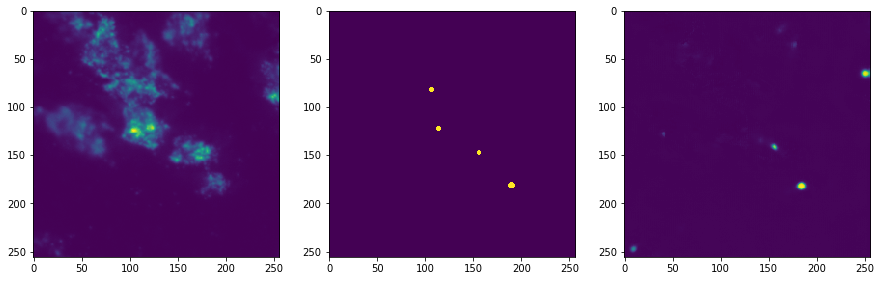

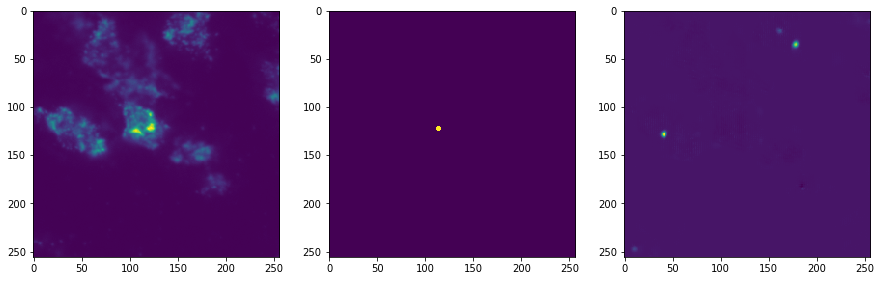

1900
Training loss:  0.00018432041
(3, 8, 256, 256, 1)
Validation loss:  0.0008684024


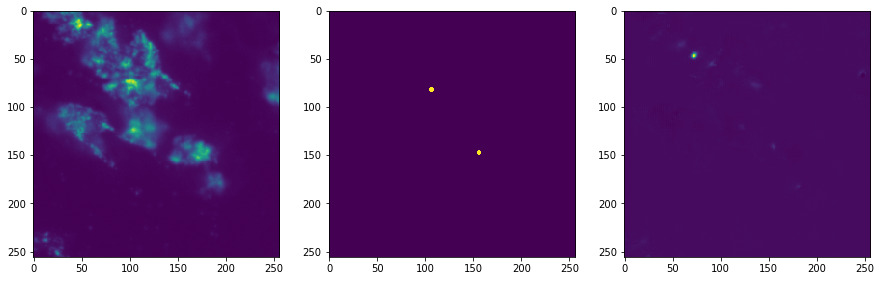

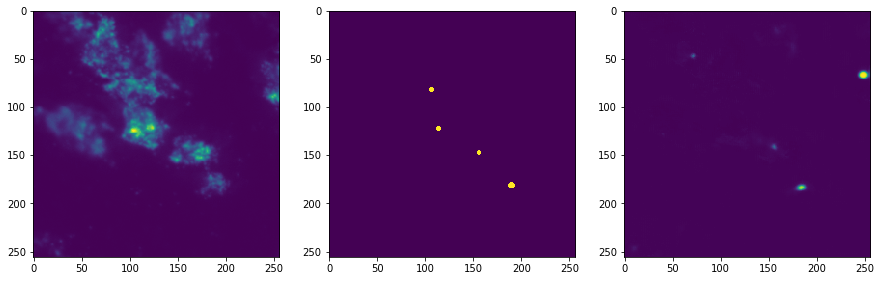

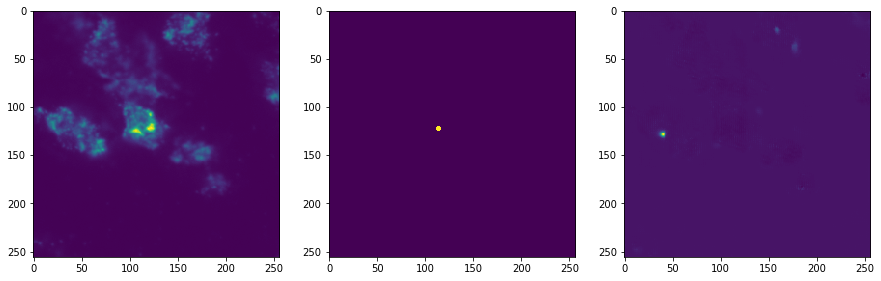

2000
Training loss:  0.0004614724
(3, 8, 256, 256, 1)
Validation loss:  0.00093086675


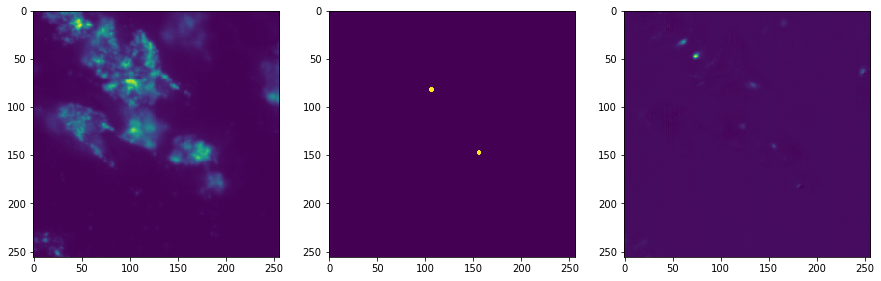

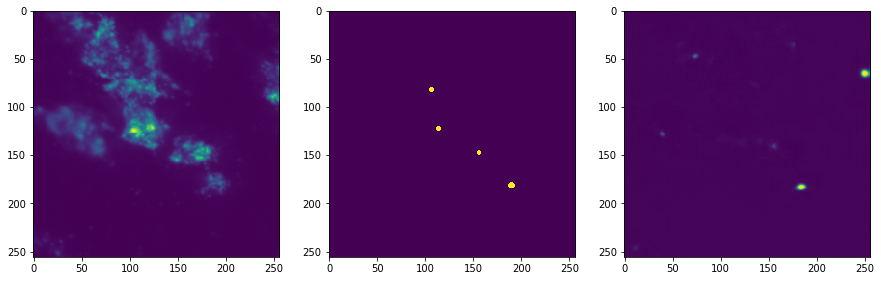

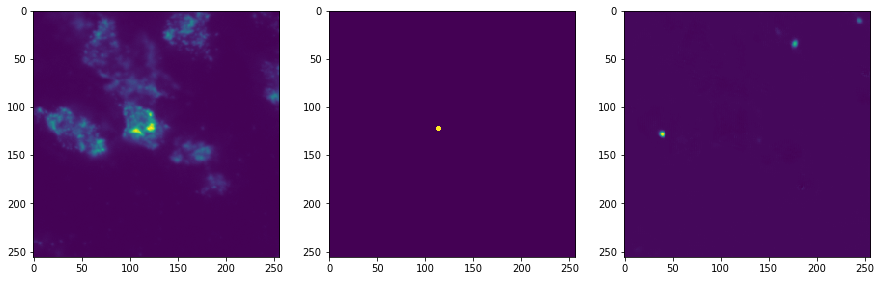

KeyboardInterrupt: 

In [18]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver(max_to_keep=50)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.000195, 0.0001, 0.00002, 0.00001]
learning_rate_steps=[500,2500, 3200, 6000]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[15])
        cur_train=train_data[idx,:,:,:]+0*np.random.uniform(-0.03, 0.03, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[0,ti*2+2,:,:,0], sub_validation_truth[0,ti*2+2,:,:,0], results[0,ti*2+2,:,:,0])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs

In [21]:
tf.train.write_graph(sess.graph_def, 'Data/NewModels/', 'saved_3100.pb', as_text=False)#1800

'Data/NewModels/saved_3100.pb'

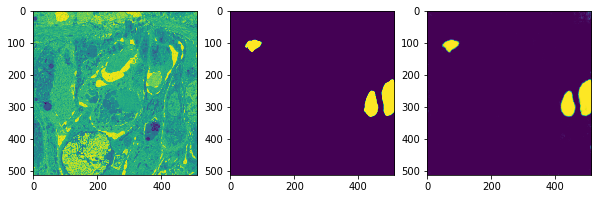

In [31]:
idx=np.random.choice(validation_data.shape[0], replace=False, size=[25])
cur_train=train_data[idx,:,:,:]
cur_truth=train_truth[idx,:,:]
results, losses=sess.run([probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})

ids=4
utils.plot_3x1(cur_train[ids,:,:,0], cur_truth[ids,:,:,0], results[ids,:,:,0])

# Process new datafiles using trained network

Load the network that works best

In [19]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

data_model=data+'NewModels/Model'+str(1700)
saver.restore(sess,data_model)

Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from /n/core/micro/asa/fgm/smc/20191029_3PO_HighMag/DeepLearn/NewModels/Model1700


Function for processing a file

In [39]:
def process_file(sess, file_path, save_dir):
    file_data=skimage.external.tifffile.imread(file_path)
    #if (len(file_data.shape)==4):
    #file_data=np.reshape(file_data, [file_data.shape[0], 8, x_dim, x_dim, 2])
    #else:
    file_data=np.swapaxes(np.swapaxes(file_data,2,3), 3,4)
    inference_data=file_data
    
    #true_test2_data=true_test2_data/np.std(true_test2_data)*0.02
    #true_test2_data=true_test2_data-np.mean(true_test2_data)+0.55
    #v1true_test2_data=(true_test2_data-.578)/.138+0.5
    inference_data=(inference_data-mean)/std+0.5

    channels=inference_data.shape[4]
    num_images=inference_data.shape[0]
    output=np.zeros([num_images,8,256,256,2])
    process_batch_size=20
    print('Starting')
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        inference_batch_data=inference_data[t:(t+process_batch_size), :,:,:,:]
        results=sess.run(probs, feed_dict={x:inference_batch_data})
        output[t:(t+process_batch_size),:,:,:,0]=inference_batch_data[:,:,:,:,0]
        output[t:(t+process_batch_size),:,:,:,1]=results[:,:,:,:,0]
    print('Done')
    inference_data=0
    output[:,:,:,:,0]=file_data[:,:,:,:,0]
    output=np.swapaxes(np.swapaxes(output,4,3),3,2)
    np.place(output, output<0, 0)
    file_name=file_path.split('/')[-1]
    print(output.dtype)
    skimage.external.tifffile.imsave(save_dir+file_name, output.astype('float32'), imagej=True)
    print('Written')
    return output


In [40]:
test=process_file(sess, '/n/core/micro/asa/fgm/smc/20191029_3PO_HighMag/DeepLearn/Input/Test.tif', '/n/core/micro/asa/fgm/smc/20191029_3PO_HighMag/DeepLearn/Output/')

(261, 8, 256, 256, 2)
(261, 8, 256, 256, 2)
Starting
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(20, 8, 256, 256, 2)
(1, 8, 256, 256, 2)
Done
float64
Written


In [29]:
test.shape

(45, 8, 2, 128, 128)

In [14]:
import glob
for f in glob.glob('/n/projects/smc/public/STN/19-6-3b_ali_level_fullsize/DeepLearn/Data/*.tif'):
    output=process_file(sess, f, data+'v1/Output/')

Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
D

Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float

float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Wr

Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
St

Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
D

Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float

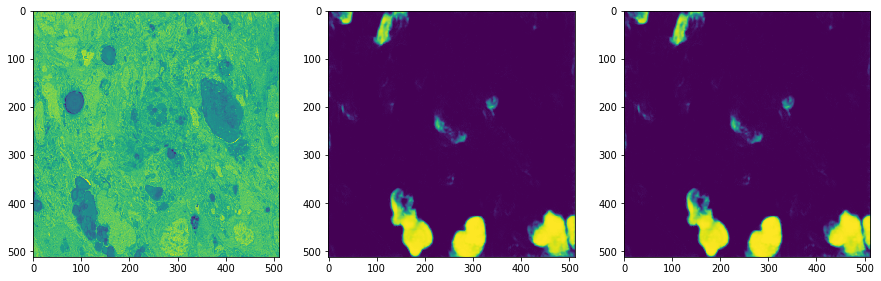

In [24]:
ids=4
utils.plot_3x1(output[ids,0,:,:], output[ids,1,:,:], output[ids,1,:,:])

# Retrain using new data and best old model

In [49]:
if os.path.isdir(data+'NewModels/'):
    os.rename(data+'NewModels/', data+'OldModels/')

In [50]:
both=skimage.external.tifffile.imread(data+'Training_retrain_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-2

In [51]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
channels=int(file.readline())
file.close()

In [52]:
train_data=both[:,:,:,0:-2]/655350.0
train_truth=both[:,:,:,[-2,-1]]

train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation_annotated.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,0:-2]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[-2,-1]]
validation_truth[np.where(validation_truth>0.1)]=1


In [56]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

#data_model=data+'OldModels/Model'+str(model)
data_model=data+'OldModels/Model'+str(1500)
saver.restore(sess,data_model)

0
Training loss:  0.01055294
(3, 512, 512, 2)
Validation loss:  0.005736654


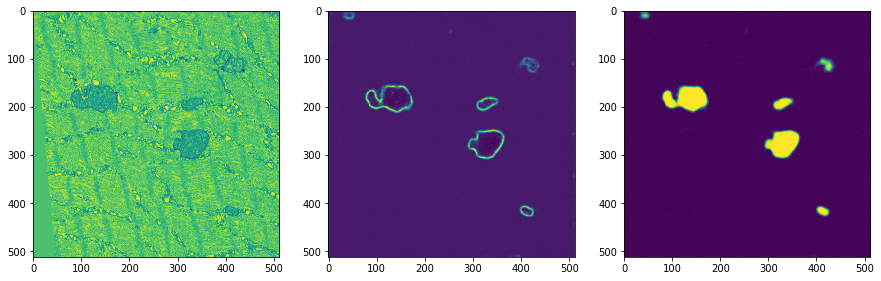

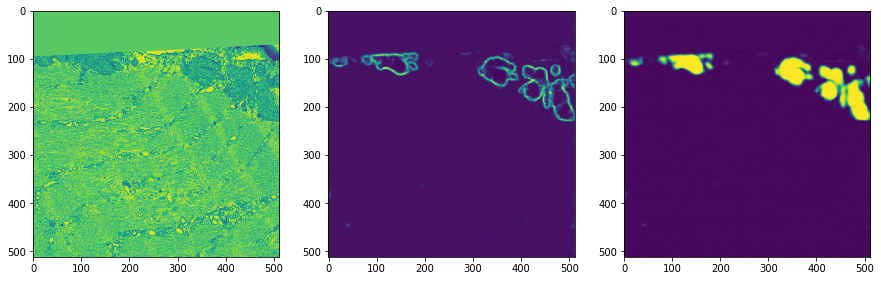

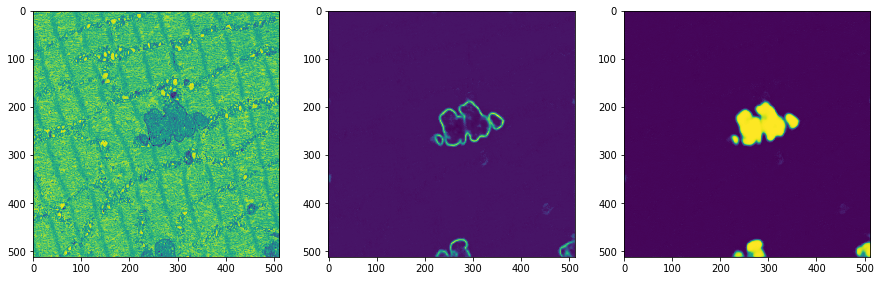

100
Training loss:  0.00900529
(3, 512, 512, 2)
Validation loss:  0.005215116


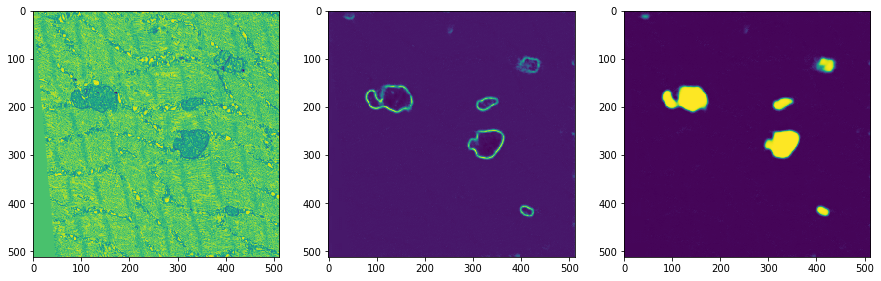

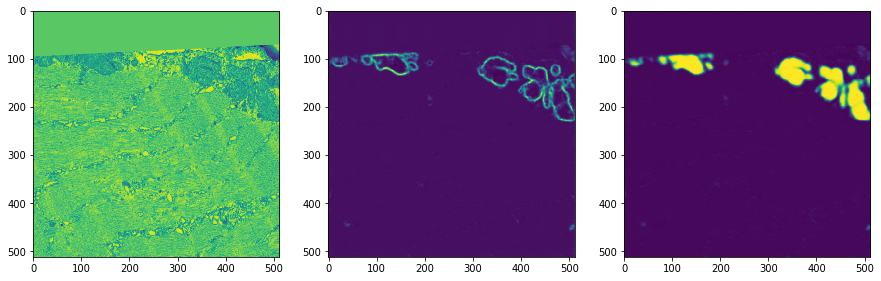

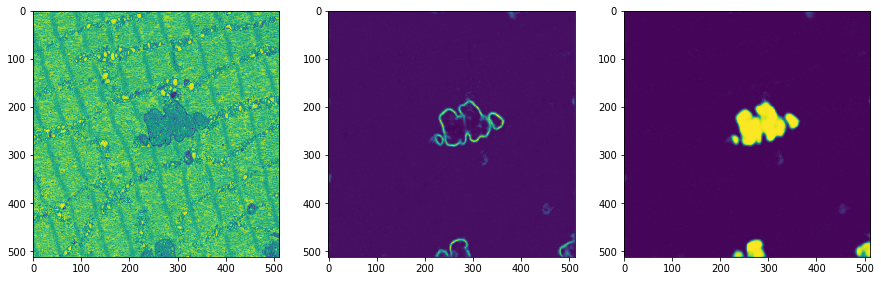

200
Training loss:  0.007782866
(3, 512, 512, 2)
Validation loss:  0.005301018


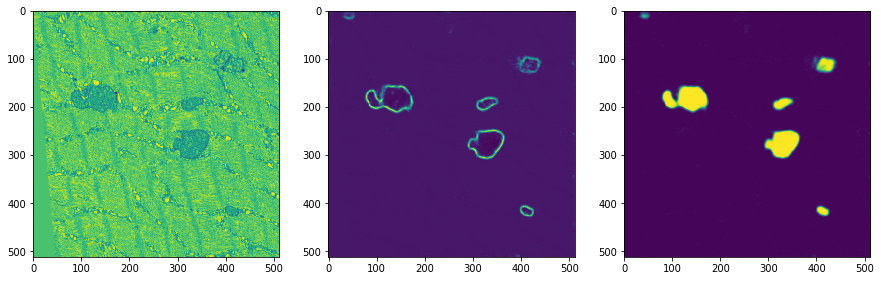

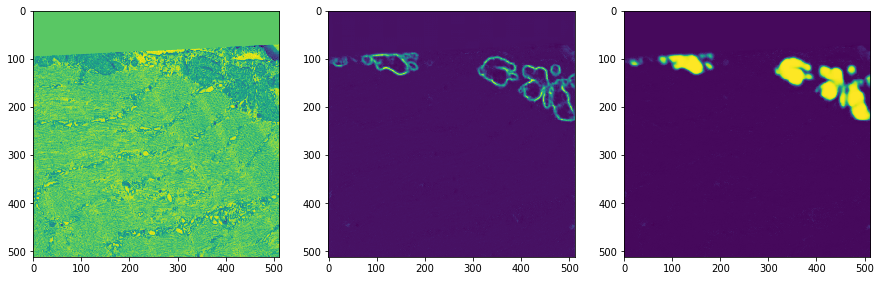

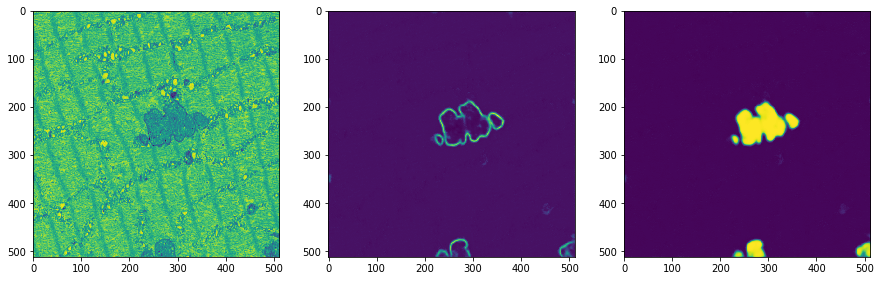

300
Training loss:  0.0063638096
(3, 512, 512, 2)
Validation loss:  0.005252032


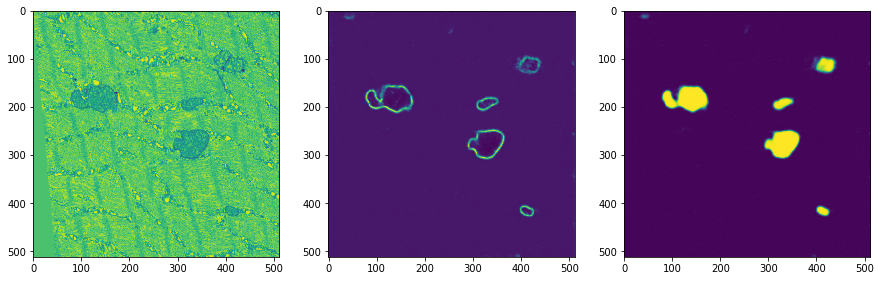

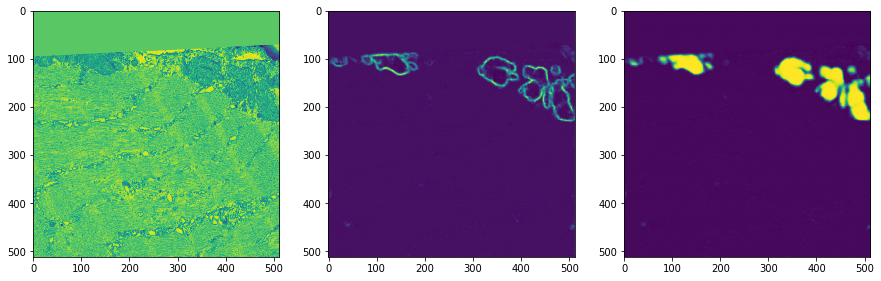

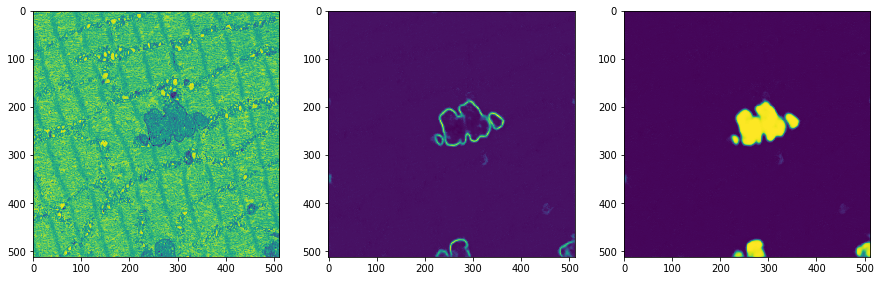

400
Training loss:  0.011437751
(3, 512, 512, 2)
Validation loss:  0.005232986


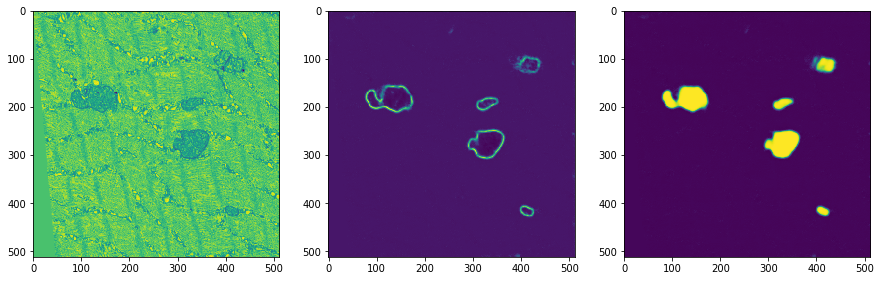

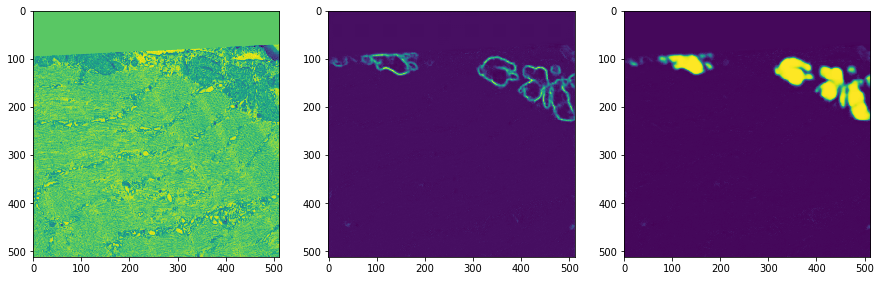

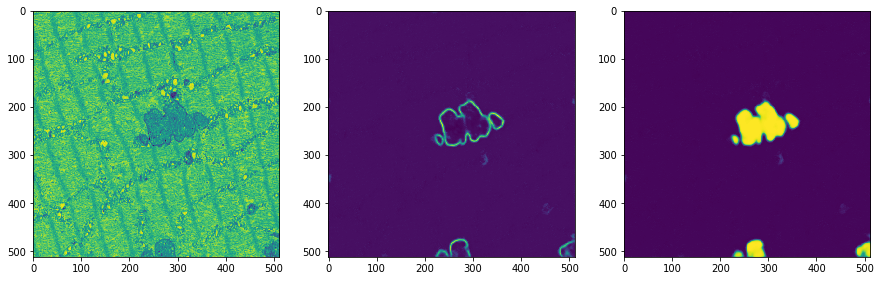

500
Training loss:  0.008659465
(3, 512, 512, 2)
Validation loss:  0.005132097


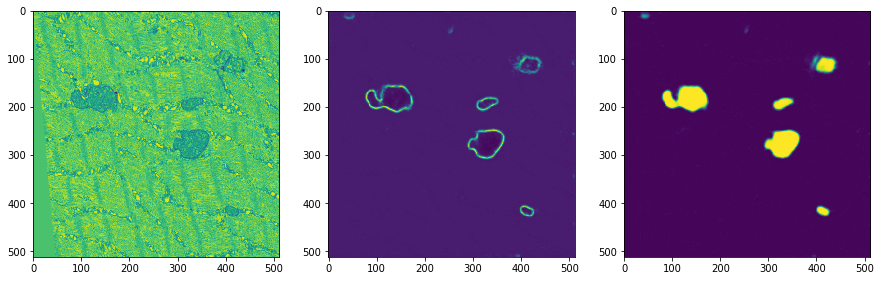

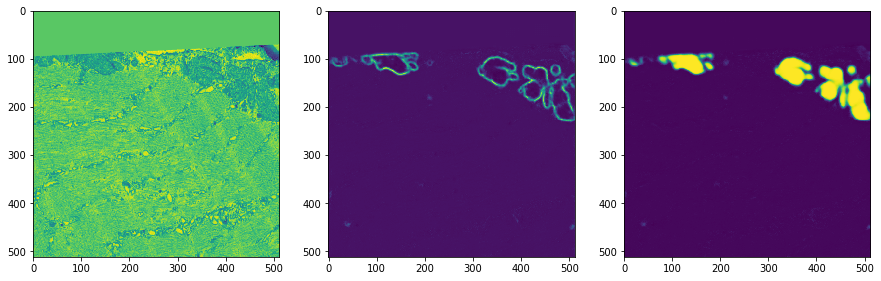

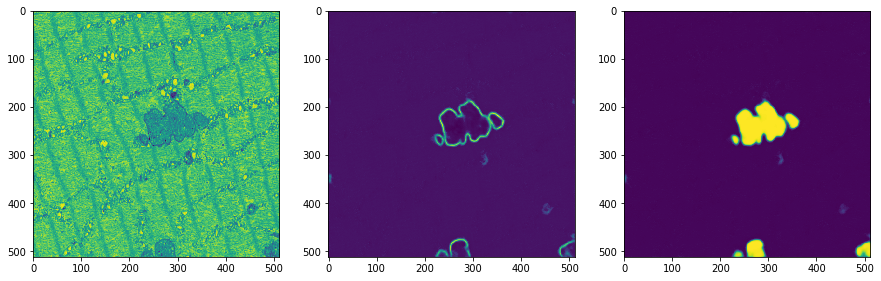

600
Training loss:  0.007433119
(3, 512, 512, 2)
Validation loss:  0.005175729


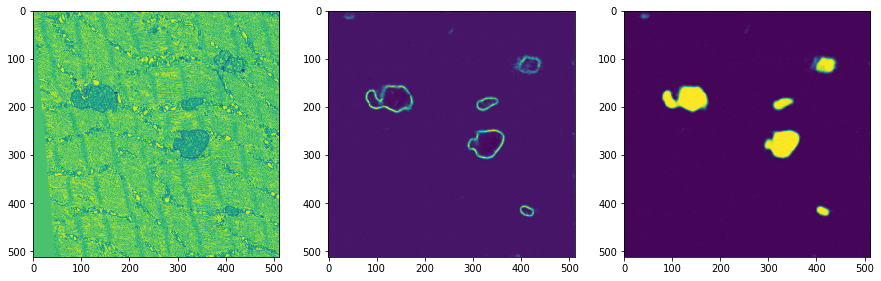

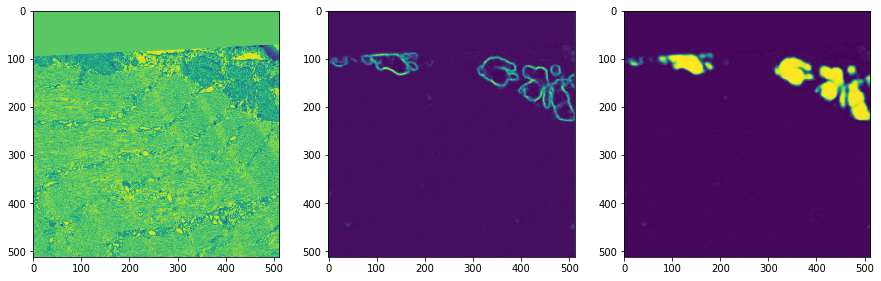

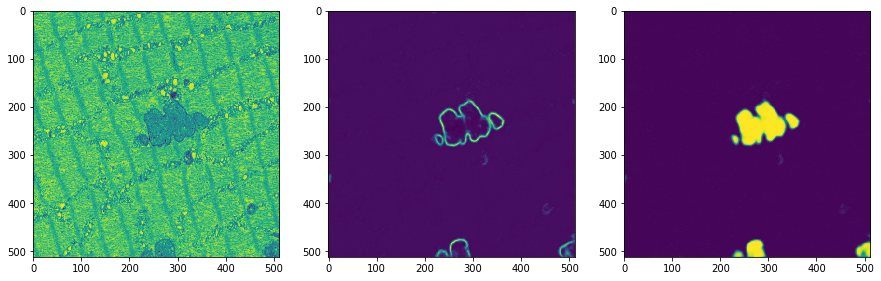

700
Training loss:  0.008370575
(3, 512, 512, 2)
Validation loss:  0.005141972


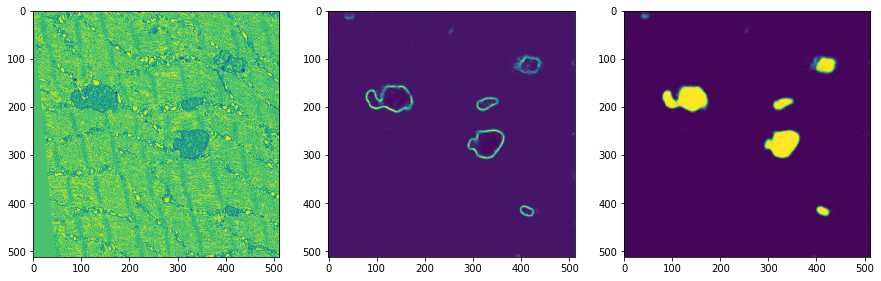

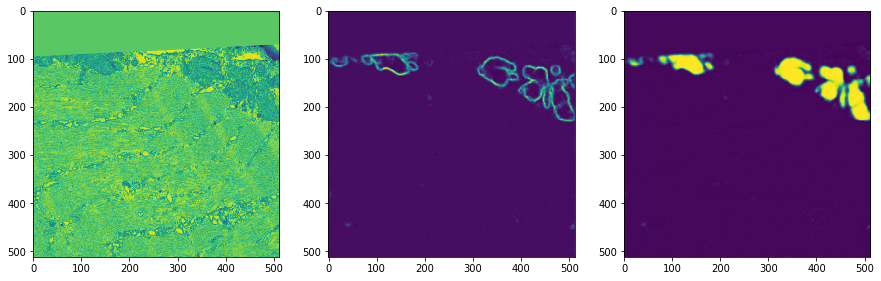

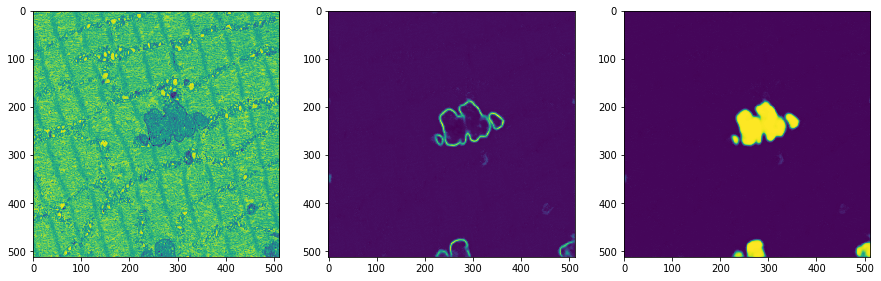

800
Training loss:  0.010153889
(3, 512, 512, 2)
Validation loss:  0.005244376


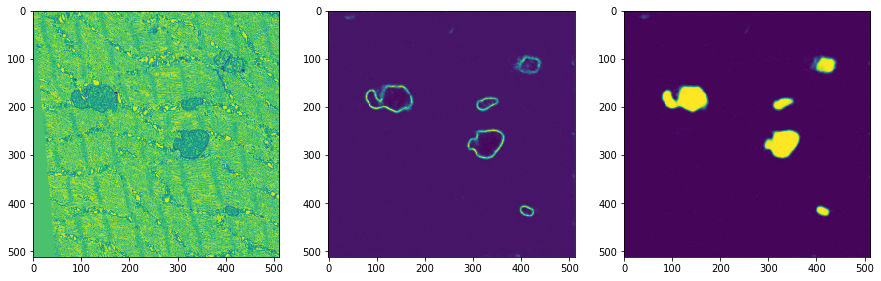

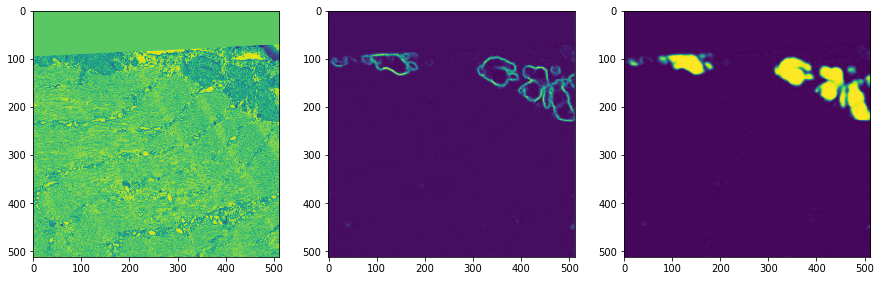

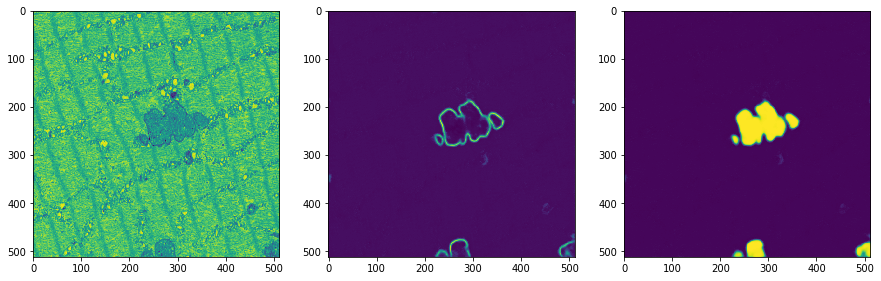

900
Training loss:  0.00825664
(3, 512, 512, 2)
Validation loss:  0.005039207


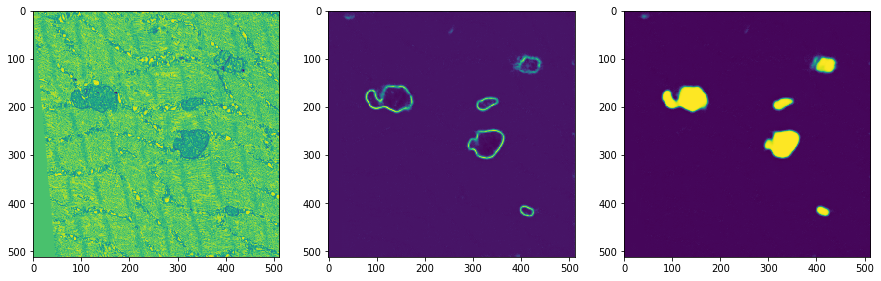

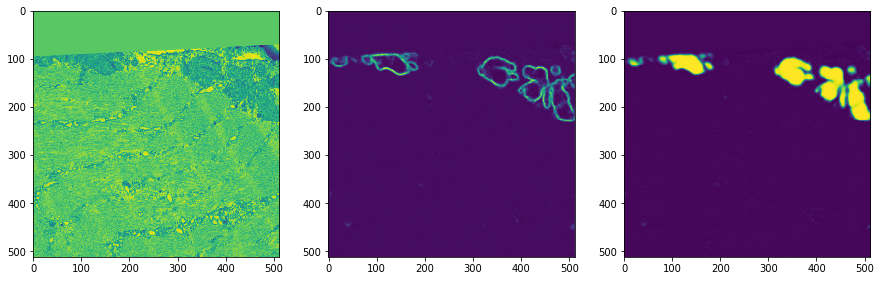

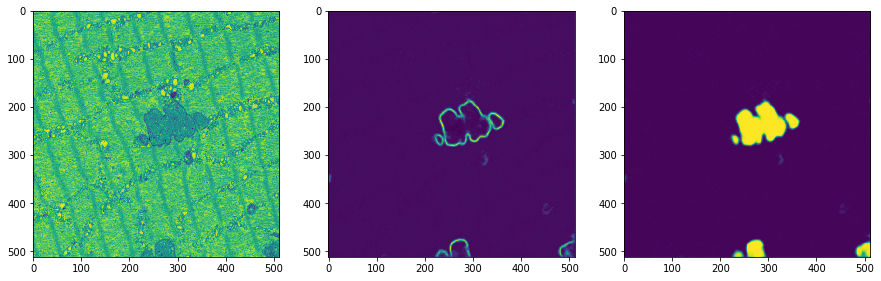

1000
Training loss:  0.009528242
(3, 512, 512, 2)
Validation loss:  0.0051275715


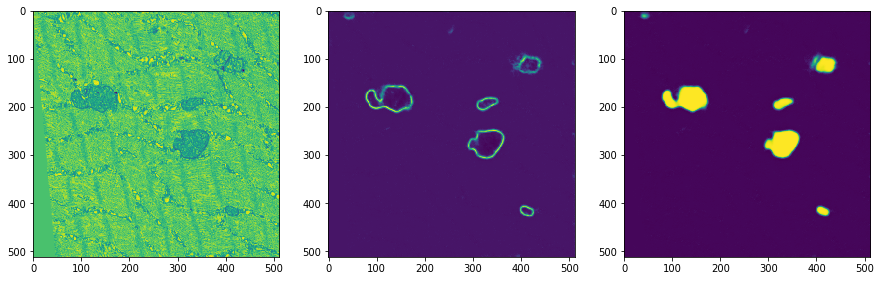

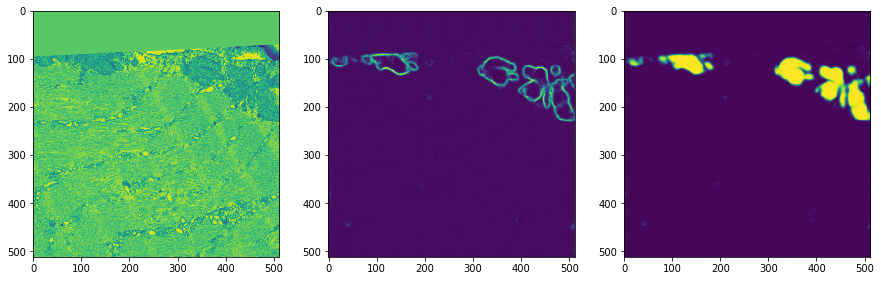

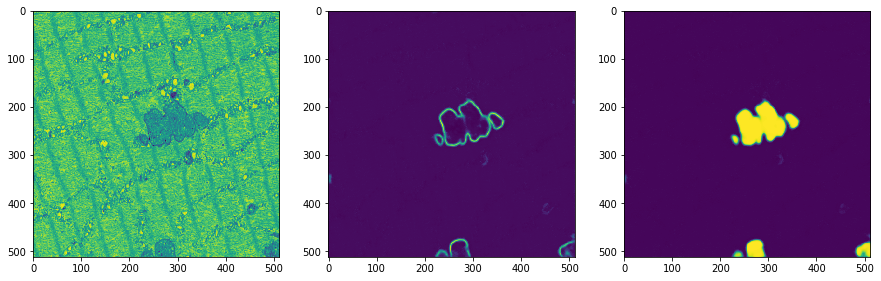

1100
Training loss:  0.0057472433
(3, 512, 512, 2)
Validation loss:  0.005115318


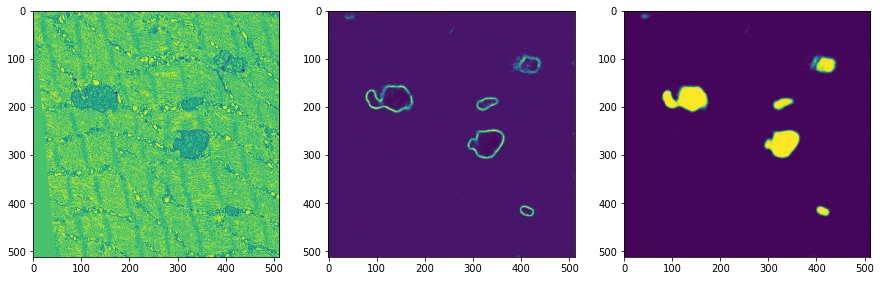

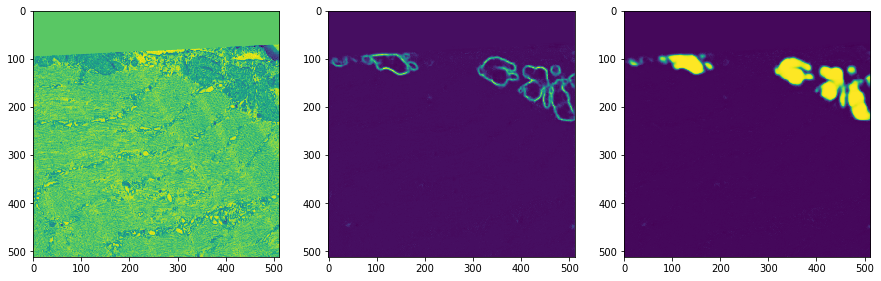

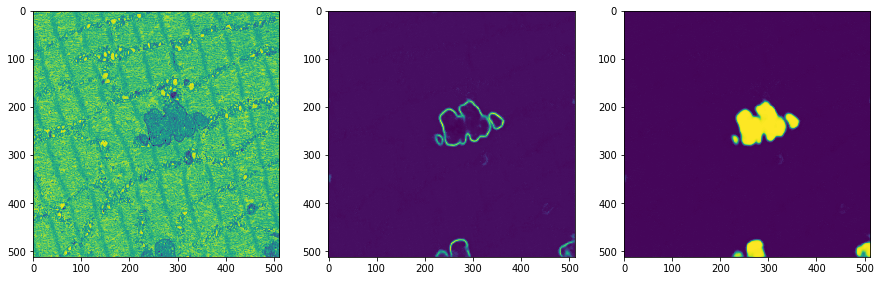

1200
Training loss:  0.0063980236
(3, 512, 512, 2)
Validation loss:  0.0049404763


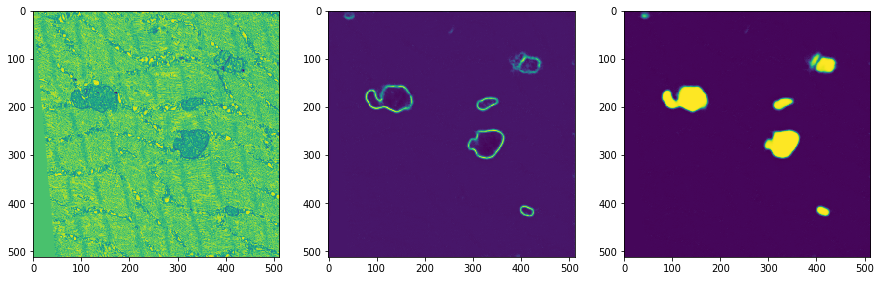

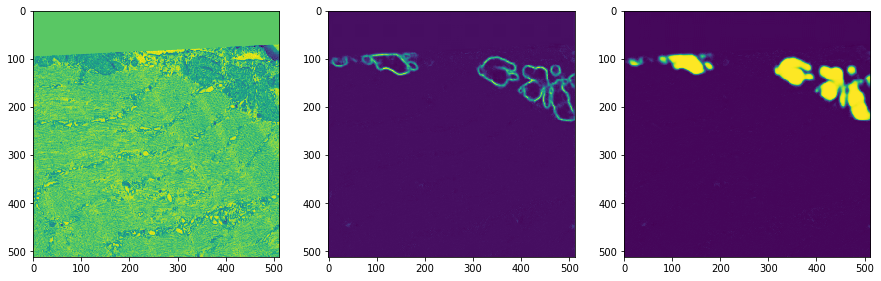

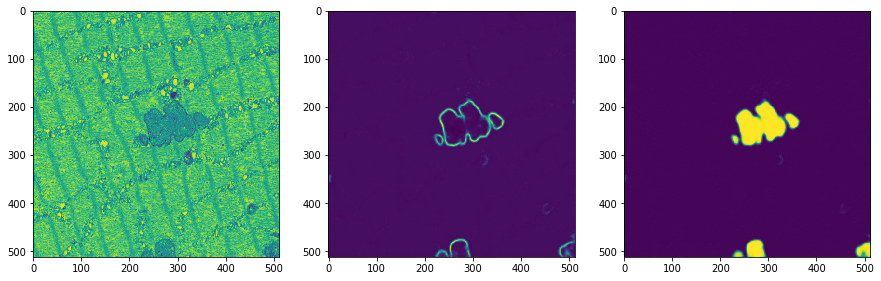

1300
Training loss:  0.009417358
(3, 512, 512, 2)
Validation loss:  0.0048163314


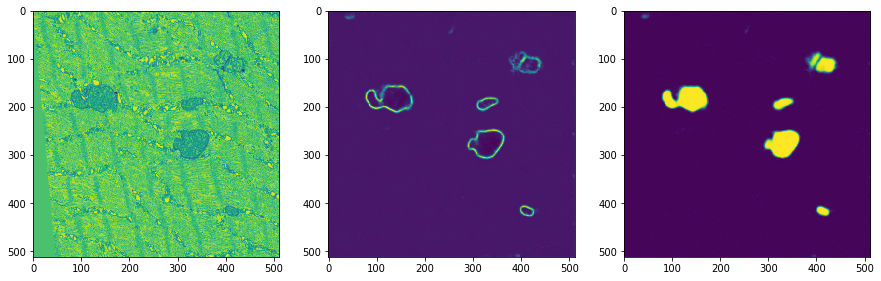

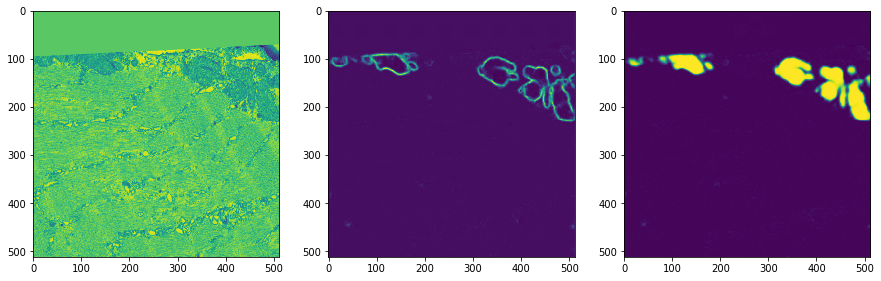

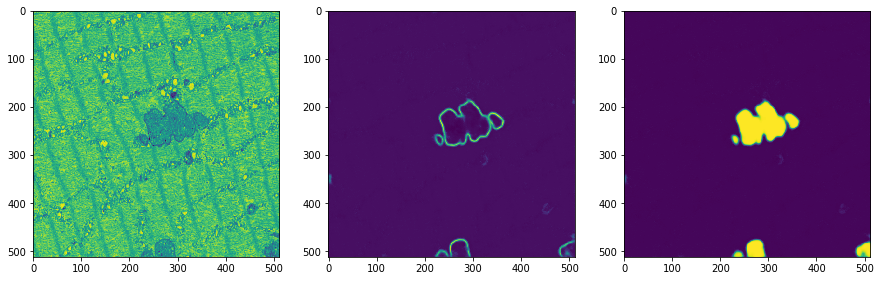

1400
Training loss:  0.008767967
(3, 512, 512, 2)
Validation loss:  0.004719852


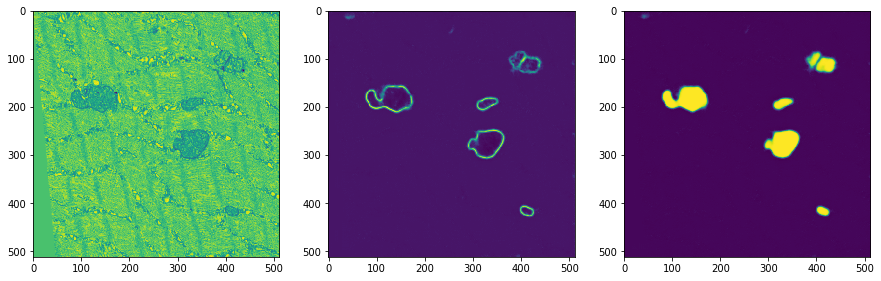

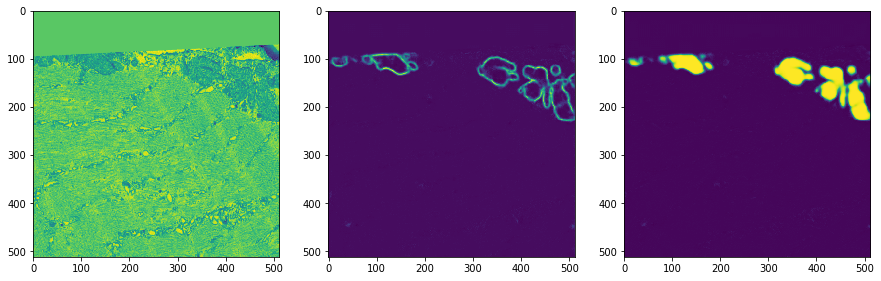

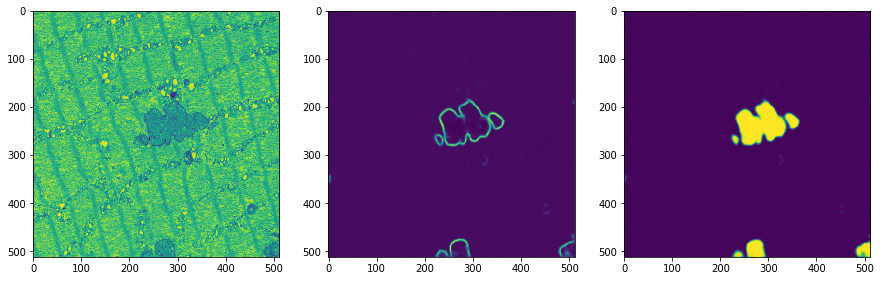

1500
Training loss:  0.008230918
(3, 512, 512, 2)
Validation loss:  0.004679288


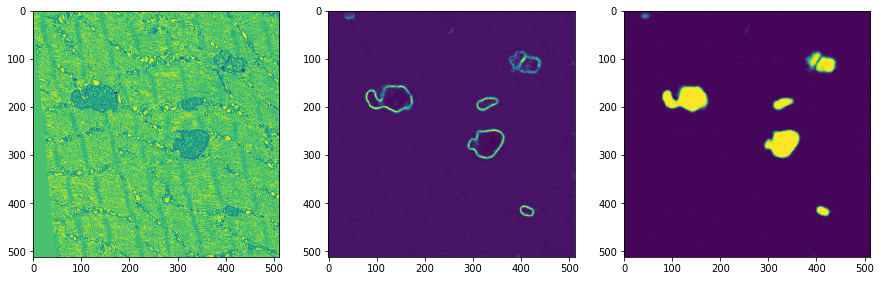

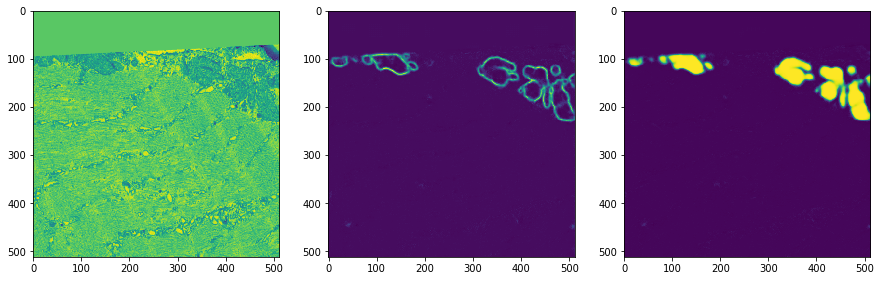

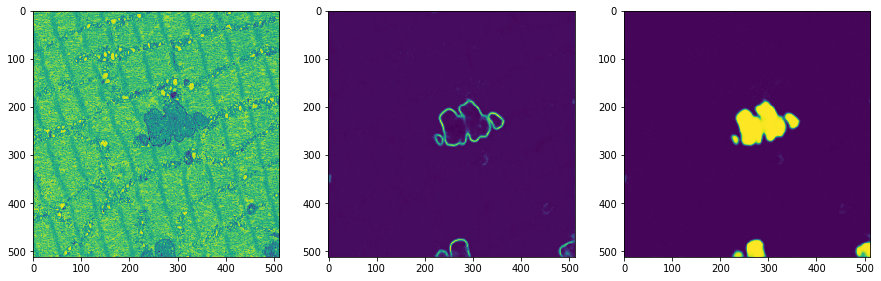

1600
Training loss:  0.007872763
(3, 512, 512, 2)
Validation loss:  0.0046318164


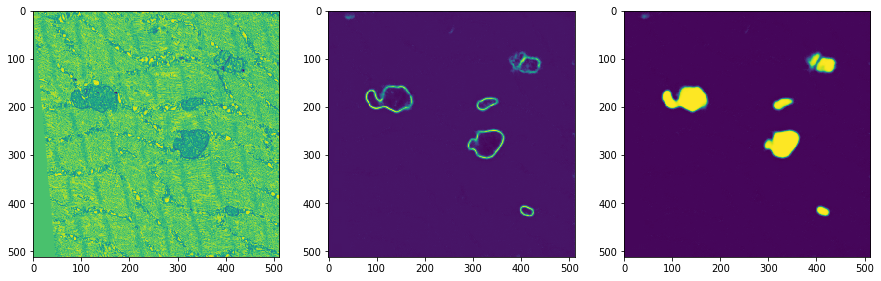

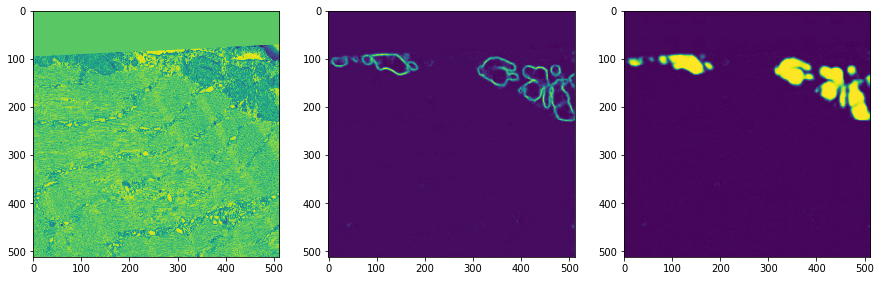

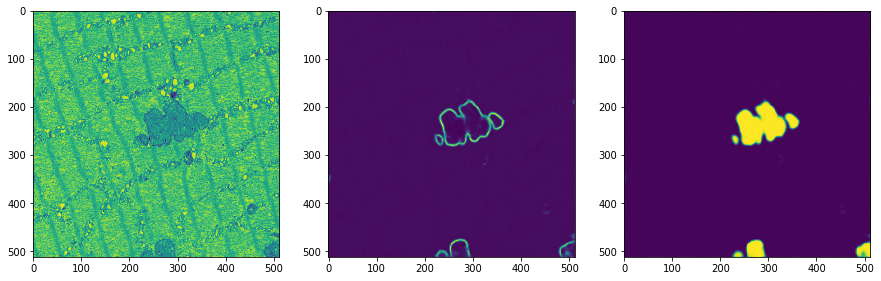

1700
Training loss:  0.007647643
(3, 512, 512, 2)
Validation loss:  0.0045695878


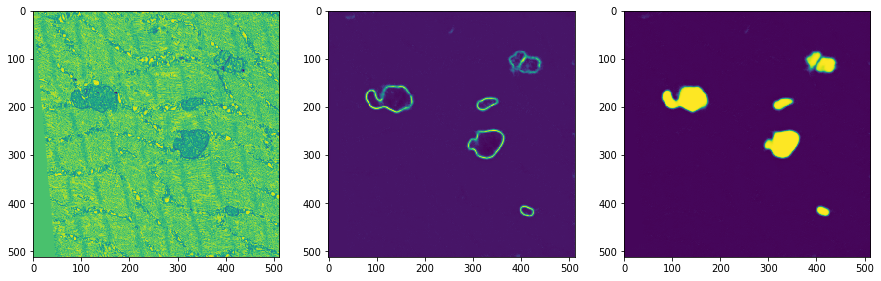

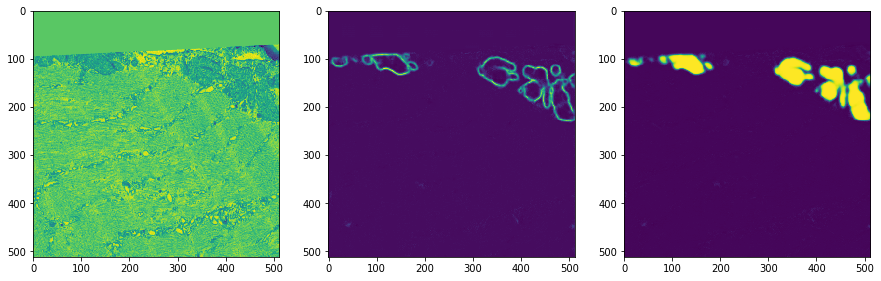

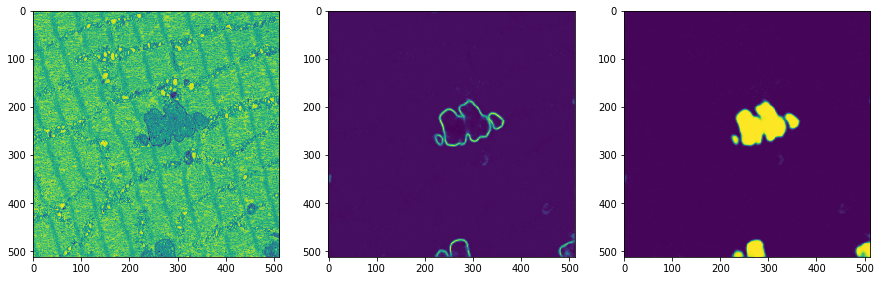

1800
Training loss:  0.005671088
(3, 512, 512, 2)
Validation loss:  0.0045387815


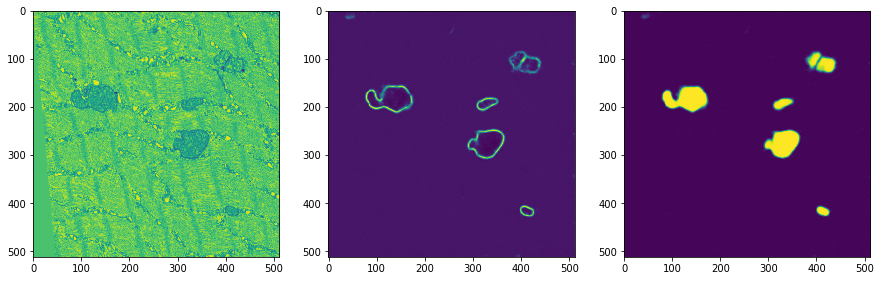

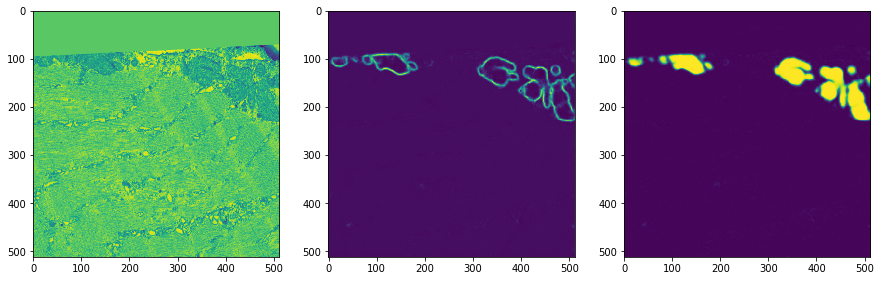

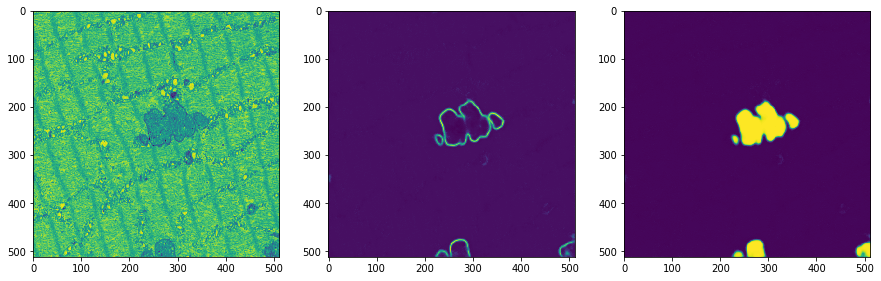

1900
Training loss:  0.0061997413
(3, 512, 512, 2)
Validation loss:  0.0044387146


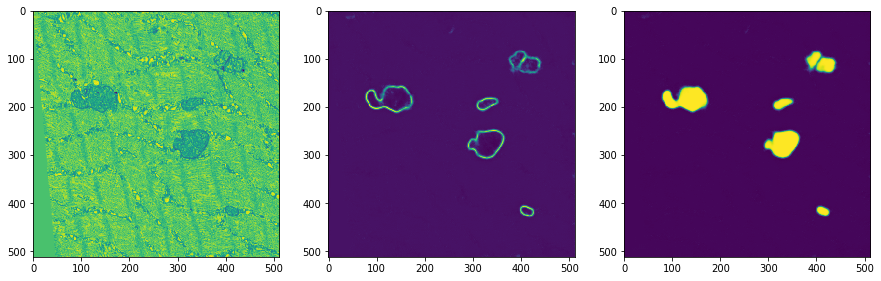

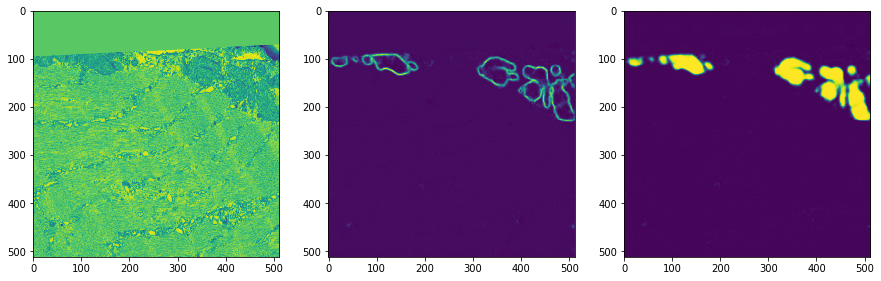

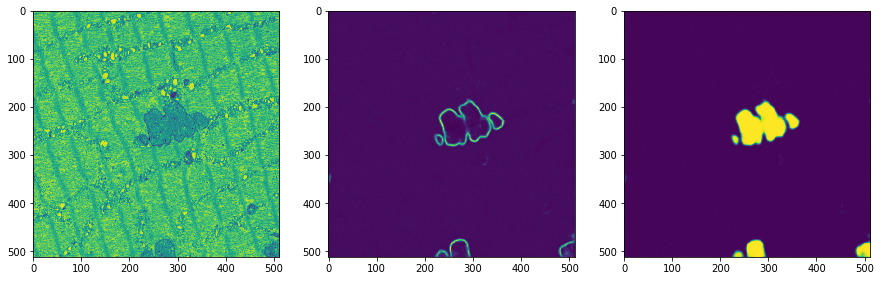

2000
Training loss:  0.005319134
(3, 512, 512, 2)
Validation loss:  0.004447524


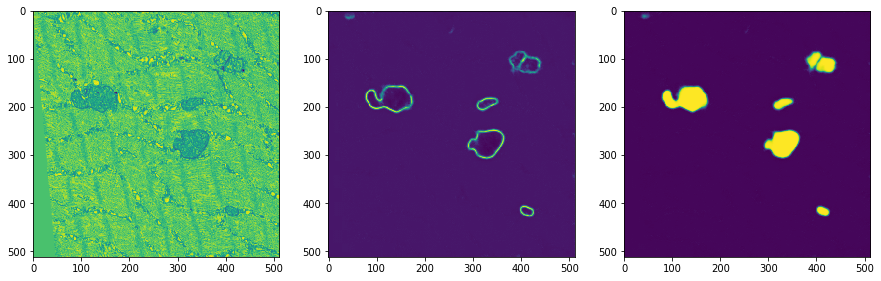

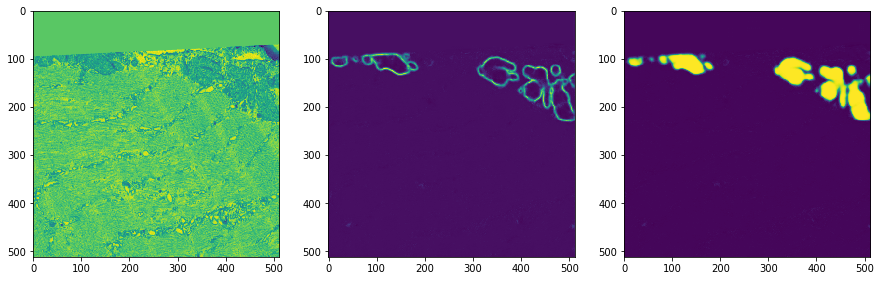

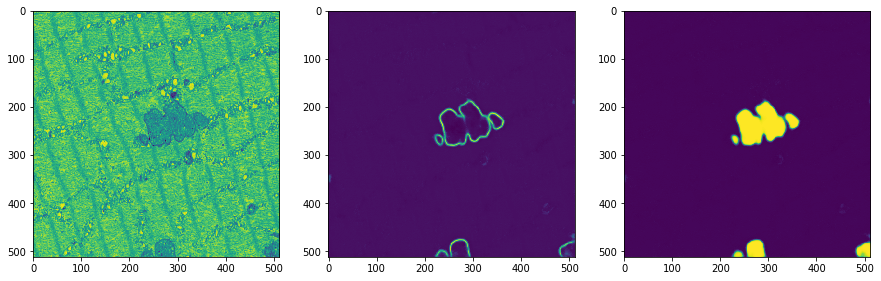

2100
Training loss:  0.0059513003
(3, 512, 512, 2)
Validation loss:  0.004334129


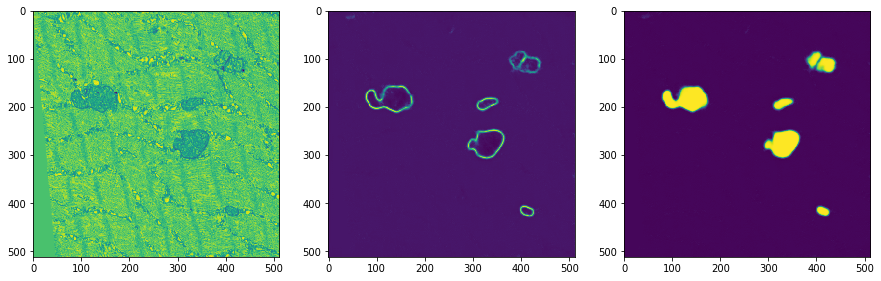

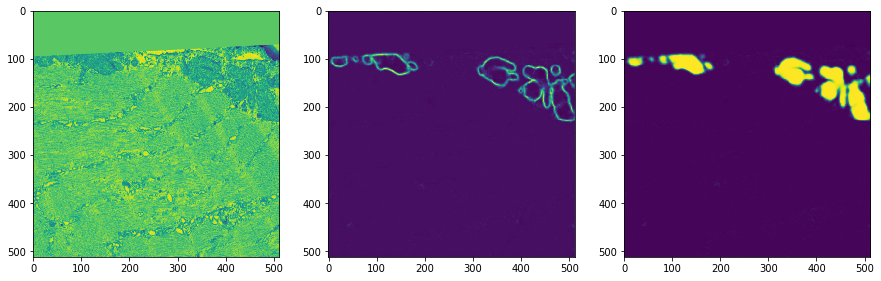

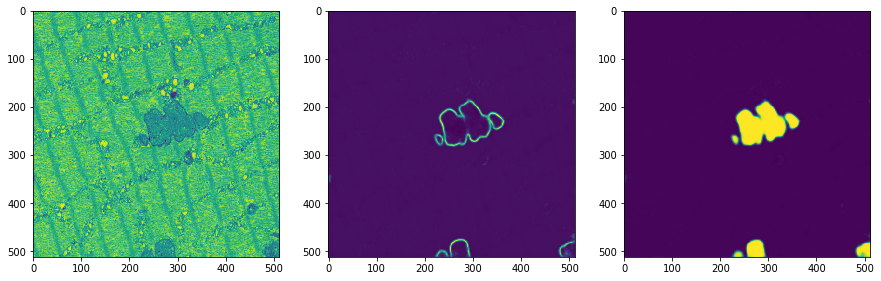

In [57]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.00005, 0.00002, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[25])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-baseline_noise, baseline_noise, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            if (losses<current_best[1]):
                current_best=[i, losses]
                file=open(data+'Network.txt', 'w')
                file.write(str(base_scaler)+'\n')
                file.write(str(baseline_noise)+'\n')
                file.write(str(x_dim)+'\n')
                file.write(str(mean)+'\n')
                file.write(str(std)+'\n')
                file.write(str(i)+'\n')
                file.write(str(channels)+'\n')
                file.close()
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], results[ti,:,:,0], results[ti,:,:,1])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs